# Часть I проекта "Прогнозирование стоимости жилья".
В этой части мы познакомимся с данными, проведем их полный анализ и обработку.

In [32]:
# импортируем библиотеки

import pandas as pd
import numpy as np
import re
import ast
import itertools

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

## Анализ и обработка данных

### Посмотрим, как обстоят дела с данными. Из чего они состоят, как выглядят, насколько полные. Оценим целевой признак.

In [33]:
# загрузим данные

data = pd.read_csv('./data/data.csv')

# посмотрим на размерность датасета, типы данных и количество пропусков
print(data.info())

display(data.head(2))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 377185 entries, 0 to 377184
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   status        337267 non-null  object
 1   private pool  4181 non-null    object
 2   propertyType  342452 non-null  object
 3   street        377183 non-null  object
 4   baths         270847 non-null  object
 5   homeFacts     377185 non-null  object
 6   fireplace     103114 non-null  object
 7   city          377151 non-null  object
 8   schools       377185 non-null  object
 9   sqft          336608 non-null  object
 10  zipcode       377185 non-null  object
 11  beds          285903 non-null  object
 12  state         377185 non-null  object
 13  stories       226469 non-null  object
 14  mls-id        24942 non-null   object
 15  PrivatePool   40311 non-null   object
 16  MlsId         310305 non-null  object
 17  target        374704 non-null  object
dtypes: object(18)
memory usa

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,NaN,611019,"$418,000"
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000"


Text(0.5, 1.0, 'Тепловая карта пропущенных значений')

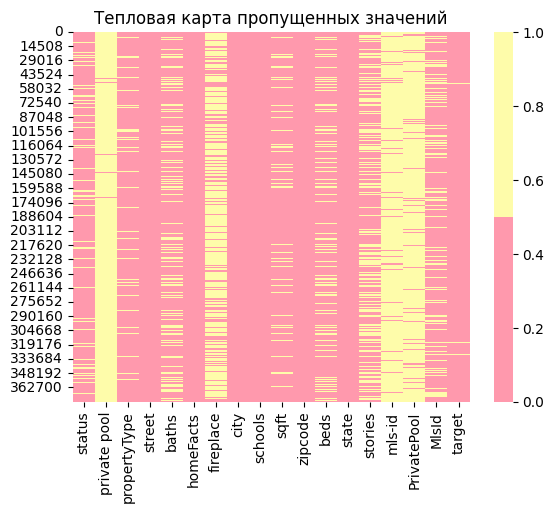

In [34]:
# построим тепловую карту пропущенных значений

colors = ['#ff99ad', '#fefcaa']
sns.heatmap(data.isnull(), cmap=sns.color_palette(colors), annot=False)
plt.title('Тепловая карта пропущенных значений')

<img src="visualisation/01.png?raw=true">

Все столбцы имеют тип данных "object", так же можно увидеть, что в некоторых колонках довольно много пропусков, например, "private pool", "mls-id", "PrivatePool", но не стоит их удалять не глядя.
Разберем все признаки по-порядку. Но прежде всего удалим полные дубликаты из данных.

In [35]:
# удалим из данных полные дубликаты и посмотрим, сколько их было
df_shape_with_duplicates = data.shape[0]
data = data.drop_duplicates().reset_index(drop=True)
print(f'Число удаленных дубликатов: {df_shape_with_duplicates - data.shape[0]}, всего строк в данных: {data.shape[0]}')

Число удаленных дубликатов: 50, всего строк в данных: 377135


In [36]:
# Дубликатов было всего 50, теперь удалим те строки, где имеется лишь 6 признаков из 18
data.dropna(axis=0, thresh=6, inplace=True)
data.shape

(377135, 18)

#### Таких строк не оказалось, разберем целевой признак - target.

In [37]:
# посмотрим на количество пропусков в столбце
data.target.isnull().sum()

2480

На данных с отсутствующим целевым признаком иы вряд ли мы сможем обучить модель. Удалим эти строки.

In [38]:
# удалим строки с пропущенными значениями
data = data.drop(data.loc[data.target.isna()].index).reset_index(drop=True)
# посмотрим, как выглядят значения колонки теперь
data.target.value_counts().index[:10]

Index(['$225,000', '$275,000', '$250,000', '$350,000', '$299,900', '$325,000',
       '$249,900', '$399,000', '$199,900', '$299,000'],
      dtype='object', name='target')

Есть запятые, знаки валюты, плюсы. Почистим значения признака так, чтобы столбец можно было перевести в числовой.

In [39]:
# удаляем все символы, кроме цифр и точки
data['target'] = data['target'].str.replace(r"[^\d\.]", "", regex=True)

# приведем столбец к числовому виду
data.target = pd.to_numeric(data.target, errors='coerce')

# заменим возможно пропуски на 0
data.target = data.target.fillna('0')

# Посмотрим, как выглядят данные ячеек
print(data.target.value_counts().index[:10])

# посмотрим на количество пропусков в столбце
print(data.target.isnull().sum())

Index([225000, 275000, 250000, 350000, 325000, 399000, 299900, 249900, 299000,
       375000],
      dtype='int64', name='target')
0


Посмотрим, что за объекты стоят более 1170000 доларов.

In [40]:
print(data.loc[data.target > 1170000].shape)
display(data.loc[data.target > 1170000][:4])

(38436, 18)


,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,CA,1.0,NaN,yes,FR19221027,2895000
3,for sale,NaN,single-family home,4311 Livingston Ave,8 Baths,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",yes,Dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...","6,457 sqft",75205,5 Beds,TX,3.0,NaN,NaN,14191809,2395000
15,New,NaN,2 Story,930 52nd St,NaN,"{'atAGlanceFacts': [{'factValue': '1905', 'fac...",NaN,Brooklyn,"[{'rating': ['8', '8', '3'], 'data': {'Distanc...",NaN,11219,NaN,NY,NaN,NaN,NaN,3182740,1650000
17,Active,NaN,Townhouse,24 W 126th St,NaN,"{'atAGlanceFacts': [{'factValue': '1899', 'fac...",NaN,New York,"[{'rating': ['2', '5', '1', '2'], 'data': {'Di...","3,325",10027,NaN,NY,NaN,NaN,NaN,4975368,2650000


In [41]:
# Сузим поиск максимально, посмотрим на объекты стоимостью более 100 млн долларов
data.loc[data.target > 100000000]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
53813,for sale,NaN,single-family home,2571 Wallingford Dr,24 Baths,"{'atAGlanceFacts': [{'factValue': '2000', 'fac...",yes,Beverly Hills,"[{'rating': ['7/10', '5/10', '10/10'], 'data':...","38,000 sqft",90210,12 Beds,CA,2.0,NaN,yes,19512408,110000000
109361,for sale,NaN,single-family home,Tortuoso Way,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Los Angeles,"[{'rating': ['7/10', '5/10', '10/10'], 'data':...",NaN,90077,NaN,CA,NaN,NaN,yes,19525850,150000000
119068,For sale,NaN,Single Family,141 S Carolwood Dr,10.0,"{'atAGlanceFacts': [{'factValue': '1936', 'fac...",Yes,Los Angeles,"[{'rating': ['10/10', '5/10', '7/10'], 'data':...","12,201",90077,9,CA,3,NaN,Yes,19479370,115000000
131554,For sale,NaN,Single Family,875 Nimes Rd,18.0,"{'atAGlanceFacts': [{'factValue': '1935', 'fac...",Yes,Los Angeles,"[{'rating': ['10/10', '7/10'], 'data': {'Dista...",--,90077,11,CA,2,NaN,Yes,18398466,195000000
142589,for sale,NaN,single-family home,67 Beverly Park Ct,23 Baths,"{'atAGlanceFacts': [{'factValue': '1998', 'fac...",yes,Beverly Hills,"[{'rating': ['7/10', '5/10', '10/10'], 'data':...","28,660 sqft",90210,20 Beds,CA,3.0,NaN,yes,18386780,165000000
177747,For sale,NaN,Single Family,9505 Lania Ln,23.0,"{'atAGlanceFacts': [{'factValue': '2002', 'fac...",Yes,Beverly Hills,"[{'rating': ['10/10', '5/10', '7/10'], 'data':...","43,000",90210,12,CA,3,NaN,Yes,19-532190,129000000
284115,For sale,NaN,Single Family,67 Beverly Park Ct,23.0,"{'atAGlanceFacts': [{'factValue': '1998', 'fac...",Yes,Beverly Hills,"[{'rating': ['10/10', '5/10', '7/10'], 'data':...","28,660",90210,20,CA,3,NaN,Yes,18386780,165000000
292274,for sale,NaN,single-family home,141 S Carolwood Dr,10 Baths,"{'atAGlanceFacts': [{'factValue': '1936', 'fac...",yes,Los Angeles,"[{'rating': ['7/10', '5/10', '10/10'], 'data':...","12,201 sqft",90077,9 Beds,CA,3.0,NaN,yes,19479370,115000000
351898,for sale,NaN,lot/land,1441 Angelo Dr,NaN,"{'atAGlanceFacts': [{'factValue': '2007', 'fac...",NaN,Beverly Hills,"[{'rating': ['7/10', '5/10', '10/10'], 'data':...",741 sqft,90210,NaN,CA,NaN,NaN,NaN,19516808,110000000


Несмотря на то, что довольно много признаков у некоторых объектов отсутствует, можно предположить, что такие стоимости могут быть реальны. Жилье выглядит довольно элитным. К примеру, вот что мы видим по адресу 141 S Carolwood Dr, Los Angeles:

<img src="pictures/001.png?raw=true">

Или 67 Beverly Park Ct, Beverly Hills

<img src="pictures/002.png?raw=true">

Не будем бороться с роскошью, пусть она остается в наших данных. Посмотрим то, что ничего не стоит?

In [42]:
print(data.loc[data.target < 20].shape)
display(data.loc[data.target < 20][:8])

(18, 18)


,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
15426,Active,NaN,Single Family Home,1230 Old Dickerson Rd,2,"{'atAGlanceFacts': [{'factValue': '1940', 'fac...",NaN,Goodlettsville,"[{'rating': ['3', '2', '3', '3', '2', '1', 'NR...",1596,37072,3.0,TN,1.00,NaN,NaN,2108367,1
25168,NaN,NaN,Single Family,3205 N High School Rd,1.0,"{'atAGlanceFacts': [{'factValue': '1957', 'fac...",Yes,Indianapolis,"[{'rating': ['2/10', 'NA', '1/10'], 'data': {'...","1,586",46224,3,IN,0,NaN,NaN,21683478,1
84398,foreclosure,NaN,lot/land,7804 Hamilton Ave,NaN,"{'atAGlanceFacts': [{'factValue': '1865', 'fac...",yes,Cincinnati,"[{'rating': ['2/10'], 'data': {'Distance': ['0...","2,536 sqft",45231,6 Beds,OH,2.0,NaN,NaN,1623043,1
147276,Active,NaN,Land,Cummings St,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Huntley,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,60142,NaN,IL,NaN,NaN,NaN,07629114,1
160997,Active,NaN,NaN,1451 Unit 1491 N Federal Hwy,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Fort Lauderdale,"[{'rating': ['3', '5', '7'], 'data': {'Distanc...",NaN,33304,NaN,FL,NaN,NaN,NaN,A10458107,8
176642,Active,NaN,NaN,3301 Ravenswood Rd,"1,500","{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Dania Beach,"[{'rating': ['4', '4', '3'], 'data': {'Distanc...",NaN,33312,Baths,FL,NaN,NaN,NaN,A10786268,3
204000,Active,NaN,Land,Route 47 Hwy,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Huntley,"[{'rating': ['8', '9', '8', '7', '7', 'NR'], '...",0,60142,NaN,IL,NaN,NaN,NaN,07629371,1
250626,foreclosure,NaN,lot/land,8136 Bradyville Pike,NaN,"{'atAGlanceFacts': [{'factValue': '2005', 'fac...",NaN,Murfreesboro,"[{'rating': ['5/10', '7/10', '7/10'], 'data': ...",NaN,37127,NaN,TN,NaN,NaN,NaN,2105413,1


Половина этих объектов имеет статус foreclosure — «лишён права выкупа». Это процесс, когда недвижимость переходит к кредитору из-за неуплаты ипотеки заёмщиком. Продажа foreclosure-недвижимости отличается от традиционных продаж. Может быть, указание такой низкой цены связано имеено с этим фактом. Земли тоже не рассматриваю, так как там, вероятно, другие схемы продаж.

Посмотрим на некоторые из объектов в статусе active. Возьмем 114 S Washington St, Binghamton. Выглядит как дом с привидениями. Но по факту он был продан за 139 тыс. долларов, а в наших данных цена 1 доллар.

<img src="pictures/003.png?raw=true">

3205 N High School Rd, Indianapolis

<img src="pictures/004.png?raw=true">

Да, это вам не Лос-Анджелес. Но объекты интересные, пусть остаются.

Далее хотелось бы пройтись по всем признакам, но у нас есть два столбца с данными, которые необходимо десереализовать. Я считаю правильным сделать это прежде, чем обрабатывать все колонки по одной. 

#### Начну с признака homeFacts - сведения о строительстве объекта.

In [43]:
# посмотрим на количество пропусков в столбце
print(data.homeFacts.isnull().sum())

# посмотрим, как выглядит ячейка
print(data.homeFacts[300])

0
{'atAGlanceFacts': [{'factValue': '1954', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': 'Other', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Cooling'}, {'factValue': '', 'factLabel': 'Parking'}, {'factValue': '980 sqft', 'factLabel': 'lotsize'}, {'factValue': '$393/sqft', 'factLabel': 'Price/sqft'}]}


Пропусков не обнаружено, структуру данных себе представляем, значит, можем приступить к обработке. Нам необходимо десереализовать данные столбца и поместить их в новые колонки.

In [44]:
# сделаем из данных столбца список списков со словарями

homefacts_list = data.homeFacts.astype(str).tolist()
homefacts_lists = [ast.literal_eval(x) for x in homefacts_list]
homefacts_lists[:2]

[{'atAGlanceFacts': [{'factValue': '2019', 'factLabel': 'Year built'},
   {'factValue': '', 'factLabel': 'Remodeled year'},
   {'factValue': 'Central A/C, Heat Pump', 'factLabel': 'Heating'},
   {'factValue': '', 'factLabel': 'Cooling'},
   {'factValue': '', 'factLabel': 'Parking'},
   {'factValue': None, 'factLabel': 'lotsize'},
   {'factValue': '$144', 'factLabel': 'Price/sqft'}]},
 {'atAGlanceFacts': [{'factValue': '2019', 'factLabel': 'Year built'},
   {'factValue': '', 'factLabel': 'Remodeled year'},
   {'factValue': '', 'factLabel': 'Heating'},
   {'factValue': '', 'factLabel': 'Cooling'},
   {'factValue': '', 'factLabel': 'Parking'},
   {'factValue': '5828 sqft', 'factLabel': 'lotsize'},
   {'factValue': '$159/sqft', 'factLabel': 'Price/sqft'}]}]

In [45]:
# развернем словари, ключ atAGlanceFacts нам ни к чему

atAGlanceFacts = [x['atAGlanceFacts'] for x in homefacts_lists]
atAGlanceFacts[:2]

[[{'factValue': '2019', 'factLabel': 'Year built'},
  {'factValue': '', 'factLabel': 'Remodeled year'},
  {'factValue': 'Central A/C, Heat Pump', 'factLabel': 'Heating'},
  {'factValue': '', 'factLabel': 'Cooling'},
  {'factValue': '', 'factLabel': 'Parking'},
  {'factValue': None, 'factLabel': 'lotsize'},
  {'factValue': '$144', 'factLabel': 'Price/sqft'}],
 [{'factValue': '2019', 'factLabel': 'Year built'},
  {'factValue': '', 'factLabel': 'Remodeled year'},
  {'factValue': '', 'factLabel': 'Heating'},
  {'factValue': '', 'factLabel': 'Cooling'},
  {'factValue': '', 'factLabel': 'Parking'},
  {'factValue': '5828 sqft', 'factLabel': 'lotsize'},
  {'factValue': '$159/sqft', 'factLabel': 'Price/sqft'}]]

In [46]:
# извлечем данные из полученных словарей

homeFacts = [{item['factLabel']: item['factValue'] for item in x} for x in atAGlanceFacts]
homeFacts[:2]

[{'Year built': '2019',
  'Remodeled year': '',
  'Heating': 'Central A/C, Heat Pump',
  'Cooling': '',
  'Parking': '',
  'lotsize': None,
  'Price/sqft': '$144'},
 {'Year built': '2019',
  'Remodeled year': '',
  'Heating': '',
  'Cooling': '',
  'Parking': '',
  'lotsize': '5828 sqft',
  'Price/sqft': '$159/sqft'}]

In [47]:
# создадим датафрейм с извлеченными данными

df_homeFacts = pd.DataFrame(homeFacts)
df_homeFacts.shape

(374655, 7)

In [48]:
# объединим датафреймы
 
data = pd.concat([data, df_homeFacts], axis=1)
data.shape

(374655, 25)

#### Извлечем данные из признака schools — сведения о школах в районе.

In [49]:
# посмотрим на количество пропусков в столбце
print(data.schools.isnull().sum())

# посмотрим, как выглядит ячейка
print(data.schools[300])

0
[{'rating': ['5/10', '8/10', '10/10'], 'data': {'Distance': ['1.29mi', '0.49mi', '0.22mi'], 'Grades': ['9-12', '6-8', 'PK-5']}, 'name': ['Benjamin N Cardozo High School', 'Jhs 67 Louis Pasteur', 'Ps 221 The North Hills School']}]


В ячейке содержится информация обо всех школах, находящихся на определенном расстоянии от объекта. В целом при покупке жилья люди, конечно, изучают инфраструктуру и школы в районе, однако рейтинг или расстояние до конкретной школы(учитывая наличие других важных признаков в данных), вряд ли много скажут нам, к тому же там имеется довольно много пропущенных значений. Но имеет смысл посчитать количество школ рядом с каждым объектом и добавить эту информацию в наш датафрейм. 

In [50]:
# сделаем из данных столбца отдельный список со словарями

schools_list = data.schools.astype(str).tolist()
schools_list = [ast.literal_eval(x) for x in schools_list]
schools_list = list(itertools.chain.from_iterable(schools_list))
schools_list[:2]

[{'rating': ['4', '4', '7', 'NR', '4', '7', 'NR', 'NR'],
  'data': {'Distance': ['2.7 mi',
    '3.6 mi',
    '5.1 mi',
    '4.0 mi',
    '10.5 mi',
    '12.6 mi',
    '2.7 mi',
    '3.1 mi'],
   'Grades': ['3–5', '6–8', '9–12', 'PK–2', '6–8', '9–12', 'PK–5', 'K–12']},
  'name': ['Southern Pines Elementary School',
   'Southern Middle School',
   'Pinecrest High School',
   'Southern Pines Primary School',
   "Crain's Creek Middle School",
   'Union Pines High School',
   'Episcopal Day Private School',
   'Calvary Christian Private School']},
 {'rating': ['4/10', 'None/10', '4/10'],
  'data': {'Distance': ['1.65mi', '1.32mi', '1.01mi'],
   'Grades': ['9-12', '3-8', 'PK-8']},
  'name': ['East Valley High School&Extension',
   'Eastvalley Middle School',
   'Trentwood Elementary School']}]

In [51]:
# создадим датафрейм с количеством школ рядом с каждым объектом для дальнейшего объединения
schools_rating_list = [len(x['rating']) for x in schools_list]

school_rating_count = pd.DataFrame(schools_rating_list)
school_rating_count.columns = ['school_rating_count']
school_rating_count.tail(3)

,school_rating_count
374652,2
374653,3
374654,3


In [52]:
# объединим датафреймы
 
data = pd.concat([data, school_rating_count], axis=1)
data.tail(2)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count
374653,NaN,NaN,NaN,7810 Pereida St,NaN,"{'atAGlanceFacts': [{'factValue': None, 'factL...",NaN,Houston,"[{'rating': ['NA', 'NA', 'NA'], 'data': {'Dist...",NaN,...,NaN,34500,None,None,None,None,None,None,None,3
374654,NaN,NaN,Single Family,5983 Midcrown Dr,2.0,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Not Applicable,San Antonio,"[{'rating': ['5/10', '4/10', '3/10'], 'data': ...","1,462",...,1403619,204900,2019,None,Electric,Central,No Data,"6,969 sqft",$140,3


Text(0.5, 1.0, 'Тепловая карта пропущенных значений')

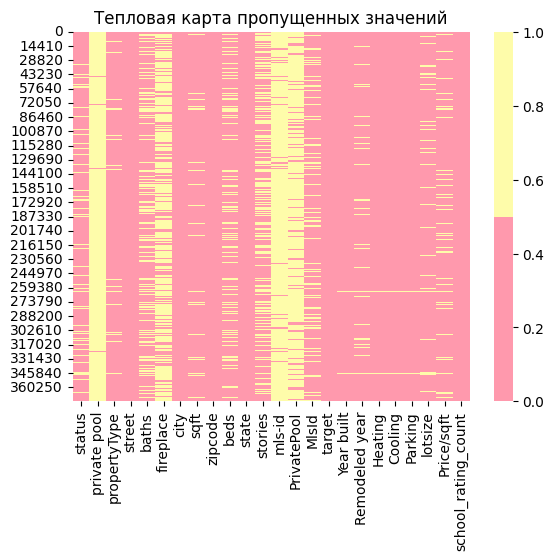

In [53]:
# удалим десериализованные колонки(homeFacts, schools)
data = data.drop(['homeFacts', 'schools'], axis=1)

# снова построим тепловую карту пропущенных значений
colors = ['#ff99ad', '#fefcaa']
sns.heatmap(data.isnull(), cmap=sns.color_palette(colors), annot=False)
plt.title('Тепловая карта пропущенных значений')

<img src="visualisation/02.png?raw=true">

В целом признаки, извлеченные из колонок homeFacts и schools имеют не настолько критично много пропусков, чтобы удалять эти признаки не глядя. Приступим к анализ всех колонок полученного датафрейма.

#### Посмотрим на признак 'status' — статус продажи.

In [54]:
# приведем все значения столбца к нижнему регистру
data.status = data.status.str.lower()
# удалим пробелы в начале и конце строки
data.status = data.status.str.strip()

# посмотрим на количество пропусков и внешний вид данных
print(data.status.isnull().sum())
print(data.status.value_counts().index[:10])

39256
Index(['for sale', 'active', 'foreclosure', 'new construction', 'pending',
       'pre-foreclosure', 'p', 'pre-foreclosure / auction',
       'under contract show', '/ auction'],
      dtype='object', name='status')


Мы видим, что есть очень популярные статусы, а есть и те, которые встречаются по одному разу. Но наши данные все еще грязные.
Нам известно, что некоторые варианты статусов недвижимости имеют несколько названий, давайте объединим их в группы, предварительно почистим статусы от лишних символов и заполним пропуски. Так же мы видели, что есть значения, включающие в себя "coming soon" и дату, объединим все "coming soon" в одно значение. После посмотрим, что из этого вышло.

In [55]:
# заменим пропущенные значения
data.status = data.status.fillna('no status')

# почистим немного недостатки с помощью функции

def get_clean_status(status):
    status = status.replace('w/', 'with ')
    status = status.replace('   ', ' ')
    status = status.replace('  ', ' ')
    return status

data.status = data.status.apply(get_clean_status)

# посмотрим на количество пропусков и внешний вид данных
print(data.status.isna().sum())
print(data.status.value_counts().index[:10])

0
Index(['for sale', 'active', 'no status', 'foreclosure', 'new construction',
       'pending', 'pre-foreclosure', 'p', 'pre-foreclosure / auction',
       'under contract show'],
      dtype='object', name='status')


In [56]:
# заменим coming_soon с помощью функции
def get_coming_soon(status):
    if 'coming soon' in status:
        return 'coming soon'
    else:
        return status

data.status = data.status.apply(get_coming_soon)

In [57]:
# заменим одинаковые по смыслу значения с помощью функции
def get_merge_statuses(status):
    # Словарь с заменами
    recurring_statuses_dict = {'foreclosure': 'foreclosed',
                           'pre foreclosure auction': 'pre foreclosure',
                           'under contract show' : 'under contract showing',
                           'under contract' : 'under contract showing',
                           'active under contract' : 'under contract showing',
                           'active backup' :  'under contract backups',
                           'backup contract':  'under contract backups',
                           'auction active': 'active auction',
                           'auction': 'active auction',
                           'activated' : 'active',
                           'contingencies' : 'contingency',
                           'pending insp finance' : 'pending inspection'
                           
                           }
    
    merged_statuses = status.map(recurring_statuses_dict).fillna(status)
    return merged_statuses

data.status = get_merge_statuses(data.status)

# уберем лишние символы из текста
def remove_special_characters(status):
    pattern = r'[^a-zA-Z ]'
    cleaned_status = re.sub(pattern, '', status)
    return cleaned_status

data.status = data.status.apply(remove_special_characters)
data.status.value_counts().index[:20]

Index(['for sale', 'active', 'no status', 'foreclosed', 'new construction',
       'pending', 'under contract showing', 'preforeclosure', 'p',
       'preforeclosure  auction', ' auction', 'new', 'contingent',
       'price change', 'active auction', 'a active', 'for rent',
       'under contract backups', 'contingent finance and inspection',
       'pending continue to show'],
      dtype='object', name='status')

Есть необходимость доработать этот признак еще немного.

In [58]:
def get_clean_status(arg):
    if 'active' in arg and 'conting' in arg:
        return 'active contingent'
    if 'continue' in arg and 'show' in arg:
        return 'continue show'
    if 'new' in arg:
        return 'new construction'
    if 'under' in arg and 'contr' in arg and 'show' in arg:
        return 'under contract show'
    if 'preforeclos' in arg and 'auction' in arg:
        return 'preforeclosure auction'
    if 'for rent' in arg:
        return 'for rent'
    if 'aucti' in arg and 'activ' in arg:
        return 'auction active'
    if 'activ' in arg and 'option' in arg:
        return 'active option'
    if 'activ' in arg and 'contr' in arg:
        return 'active with contract'
    if 'pend' in arg and 'with' in arg and 'cont' in arg:
        return 'pending with contract'
    if 'pend' in arg and 'tak' in arg and 'backup' in arg:
        return 'pending taking backup'
    if 'pend' in arg and 'want' in arg and 'backup' in arg:
        return 'pending wanted backup'
    if 'pending' in arg and 'backup' in arg and 'offer' in arg: 
        return 'pending backup offer'
    if 'pending' in arg and 'sale' in arg:
        return 'pending sale'
    if 'pf' in arg or arg =='p':
        return 'preforeclosure'
    if arg =='pi':
        return 'pending inspection'
    if arg =='c':
        return 'contingent'
    if arg =='ps':
        return 'pending sale'
    else:
        return arg
    
data['status'] = data['status'].apply(get_clean_status)
data.loc[data.status == ' auction', 'status'] = 'auction'
data.loc[data.status == 'a active', 'status'] = 'active'
data.status = data.status.replace('  ', ' ')
data.status = data.status.replace('uc', 'under contract')

data['status'].value_counts().count()

73

Количество статусов сократилось довольно значительно и выглядят они гораздо лучше, но многие статусы все еще встречаются в единственном экземпляре. Выберем 40 самых популярных статусов, отправим особо эксклюзимные варианты статусов в отдельную категорию other, таким образом мы подготовим этот признак к кодированию.

In [59]:
status_count_list = data.status.value_counts()[:39].index

def get_clean_status(status):
    if status in status_count_list:
        return status
    else:
        return 'other'
    
data.status = data.status.apply(get_clean_status)
data.status.value_counts().count()

40

In [60]:
fig = px.histogram(
    data_frame=data,
    height=1500,
    width=800,
    y = data['status'],
    title='Распределение признака status',
    color_discrete_sequence=px.colors.diverging.Tealrose   
)
fig.show()

<img src="visualisation/03.png?raw=true">

Мы видим, что у нас преобладают объекты со статусом for sale, а так же active, довольно много объектов без статуса, количество остальных статусов уже не так сильно выделяется.

#### Разберем признак 'private pool' и 'PrivatePool' — наличие собственного бассейна.

In [61]:
print(data['private pool'].value_counts())
print(data['PrivatePool'].value_counts())

private pool
Yes    4151
Name: count, dtype: int64
PrivatePool
yes    28686
Yes    11434
Name: count, dtype: int64


'private pool' и 'PrivatePool' - один и тот же признак наличия бассейна, но он разделен на две колонки. При этом имеются только значения 'yes' в разном регистре, либо пустые ячейки. Имеет смысл слить эти признаки в один. Все заполненные значения обозначим как True, а незаполненные False.

In [62]:
# объединим колонки в новую
data['privatePool'] = data['private pool'].fillna(data['PrivatePool'])

# заменим имеющиеся значения в колонках на True, остальные на False
data['privatePool'] = data['privatePool'].replace(['yes', 'Yes'], True)
data['privatePool'] = data['privatePool'].replace(np.nan, False)

# удалим первоначальные колонки и посмотрим, какие теперь значения в столбце 'privatePool'
data = data.drop(columns=['private pool', 'PrivatePool'])

data.privatePool.value_counts()

privatePool
False    330384
True      44271
Name: count, dtype: int64

Таким образом, мы видим, что большинство объектов не имеют бассейна, а признак выглядит хорошо.

#### Разберем признак 'propertyType' — тип объекта недвижимости.

In [63]:
# посмотрим на количество пропусков в столбце
data.propertyType.isnull().sum()

34554

In [64]:
# заменим все пропуски на 'no type'
data.propertyType = data.propertyType.fillna('no type')

# приведем все значения столбца к нижнему регистру
data.propertyType = data.propertyType.str.lower()

# посмотрим, какие данные содержит колонка propertyType
data.propertyType.value_counts().index[:30]

Index(['single-family home', 'single family', 'condo', 'no type',
       'single family home', 'lot/land', 'townhouse', 'land', 'multi-family',
       'condo/townhome/row home/co-op', 'traditional', 'coop', 'multi family',
       'high rise', 'ranch', 'detached, one story', 'mobile/manufactured',
       'single detached, traditional', 'contemporary', 'multi-family home',
       '1 story', 'colonial', 'mobile / manufactured', 'contemporary/modern',
       '2 stories', 'apartment', 'mfd/mobile home', 'single detached',
       'detached, two story', 'one story'],
      dtype='object', name='propertyType')

In [65]:
# Посмотрим, какие типы жилья у нас встречаются и в каком количестве
types = set()
types_list = []
for index, value in data['propertyType'].items():
    pre_types = value
    pre_types = pre_types.replace('[', '').replace(']', '')
    pre_types = pre_types.replace("'", '')
    pre_types = pre_types.split(",")
    for i in pre_types:
        types.add(i.strip())
        types_list.append(i.strip())
        
print(f'Количество уникальных типов жилья: {len(types)}')
print(f'Всего типов жилья: {len(types_list)}')

Количество уникальных типов жилья: 287
Всего типов жилья: 386177


In [66]:
# Посмотрим на самые популярные типы

types_series = pd.Series(
    data = types_list,
    index = types_list,
    name = 'types_series'
)
print('Top 20 популярных типов жилья \n ')
print(types_series.value_counts()[:20]) 

Top 20 популярных типов жилья 
 
types_series
single-family home               91370
single family                    61886
condo                            42369
no type                          34554
single family home               31725
lot/land                         20506
townhouse                        18523
land                             10933
traditional                       9677
multi-family                      7897
condo/townhome/row home/co-op     7701
coop                              3264
single detached                   3151
multi family                      2771
ranch                             2711
detached                          2671
one story                         2527
contemporary                      2328
high rise                         1980
contemporary/modern               1941
Name: count, dtype: int64


Как минимум, невооруженным глазом видно, что есть одни и те же типы, но одни указаны с пробелом, другие с дефисом. Уберем эту оплошность.

In [67]:
data['propertyType'] = data['propertyType'].str.replace('-', ' ')

data.propertyType.value_counts().count()

1262

Несмотря на то, что есть объекты, для которых указано несколько разных типов жилья, попробуем собрать похожие объекты в группы.

In [68]:
def get_clean_propertyType(arg):
    if 'single family' in arg:
        return 'single family'
    if 'condo' in arg:
        return 'condo'
    if 'lot' in arg or 'land' in arg:
        return 'land'
    if 'loft' in arg:
        return 'loft'
    if 'multi family' in arg:
        return 'multi family'
    if 'one story' in arg or '1 story' in arg:
        return '1 story'
    if 'two stor' in arg or '2 stor' in arg:
        return '2 stories'
    if 'ranch' in arg:
        return 'ranch'
    if 'other' in arg:
        return 'other'
    if 'lake' in arg:
        return 'lake house'
    
    else:
        return arg
    
data.propertyType = data.propertyType.apply(get_clean_propertyType)

print(data.propertyType.value_counts().count())

705


Мы видим, что у нас есть довольно много текстов в ячейках, при этом часть объектов имеет несколько различных характеристик. Создам отдельный признак количества характеристик для каждого объекта для эксперимента.

In [69]:
def get_types_count(type):
    if type == 'no type':
        return '0'
    else:
        type = type.split(",")
        return(len(type))

data['propertyTypeCount'] = data.propertyType.apply(get_types_count).astype(int)

data.propertyTypeCount.value_counts()

propertyTypeCount
1    335944
0     34554
2      3785
3       316
4        50
5         5
6         1
Name: count, dtype: int64

Оставлю 30 самых популярных типов жилья.

In [70]:
type_count_list = data.propertyType.value_counts()[:29].index

def get_clean_type(type):
    if type in type_count_list:
        return type
    else:
        return 'other'
    
data.propertyType = data.propertyType.apply(get_clean_type)
data.propertyType.value_counts().count()

29

В целом у меня пока нет уверенности, что этот признак в таком виде, каким я его сделала, будет полезен нам при построении модели, удалю его.

#### Разберем признаки: 
* 'street' — адрес объекта
* city — город
* zipcode — почтовый индекс
* state — штат

In [71]:
# давайте посмотрим, что мы можем извлечь полезного из признака адреса
# составим список адресов

street_list = data.street.tolist()

print(f'Датафрейм содержит {data.street.nunique()} уникальных адреса')

# выведем на экран самые популярные
data.street.value_counts().index[:10]

Датафрейм содержит 334751 уникальных адреса


Index(['Address Not Disclosed', 'Undisclosed Address', '(undisclosed Address)',
       'Address Not Available', 'Unknown Address', '2103 E State Hwy 21',
       '11305 Gulf Fwy', '17030 Youngblood Rd.', 'NE 58th Cir',
       '9470 Lancaster Rd. SW'],
      dtype='object', name='street')

Можно увидеть, что кроме самих адресов еще есть и те объекты, адрес которых не указан по разным причинам. Было бы неплохо объединить все эти фразы в один вид адреса. Для упрощения приведем весь текст к нижнему регистру.

In [72]:
# приведем все значения столбца к нижнему регистру
data.street = data.street.str.lower()

# уберем дополнительные символы из адреса
data['street'] = data['street'].str.replace('.', '')
data['street'] = data['street'].str.replace(',', '')
data['street'] = data['street'].str.replace('#' , '')
data['street'] = data['street'].str.replace('(', '')
data['street'] = data['street'].str.replace(')', '')

# посмотрим, какие данные содержит колонка propertyType
data.street.value_counts().index

# заменим пропуски
data.street = data.street.fillna('no street')

# заменим фразы, означающие отсутствие адреса в данных
def get_unknown_address(street):
    # составим список ключевых слов для фильтрации неизвестных адресов
    unknown_adress_keys = ['address', 'undisclosed', 'disclosed', 'available', 'unknown']
    words_list = street.split(' ')
    for word in words_list:
        if word in unknown_adress_keys:
            return 'no street'
        else:
            return street

data.street = data.street.apply(get_unknown_address)

# выведем на экран самые популярные
data.street.value_counts().index[:10]

Index(['no street', '2103 e state hwy 21', '11305 gulf fwy',
       '17030 youngblood rd', 'ne 58th cir', '9470 lancaster rd sw',
       '1 palmer dr', '9845 basil western rd nw', '8426 terrace valley circle',
       '6320 sw 89th court road'],
      dtype='object', name='street')

А теперь после всех этих манипуляций я решила все же удалить колонку с адресом, так как уникальных адресов очень много, а извлекать географические координаты из адреса я не буду.

In [73]:
# удалим колонку street
data = data.drop(['street'], axis=1)
data.shape

(374655, 23)

У нас имеются также другие признаки, обозначающие местоположение объекта:

* city — город
* zipcode — почтовый индекс
* state — штат

Было бы логично рассмотреть все признаки, говорящие о местоположении, в комплексе.

##### city

In [74]:
# посмотрим на количество пропусков в столбцах
print(f'Количество пропущенных значений в колонке city: {data.city.isnull().sum()}')
print(f'Количество пропущенных значений в колонке zipcode: {data.zipcode.isnull().sum()}')
print(f'Количество пропущенных значений в колонке state: {data.state.isnull().sum()}')

Количество пропущенных значений в колонке city: 34
Количество пропущенных значений в колонке zipcode: 0
Количество пропущенных значений в колонке state: 0


In [75]:
# приведем все города к единому регистру
data.city = data.city.str.capitalize()
data.city.value_counts().index[:10]

Index(['Houston', 'San antonio', 'Miami', 'Jacksonville', 'Dallas', 'Brooklyn',
       'Orlando', 'New york', 'Chicago', 'Charlotte'],
      dtype='object', name='city')

Скорее всего, мы можем восстановить потерянные 34 строки города, обратившись к другим признакам. Давайте займемся этим.

In [76]:
# посмотрим на часть пропусков в столбце city
display(data.loc[data['city'].isna()][:5])

,status,propertyType,baths,fireplace,city,sqft,zipcode,beds,state,stories,...,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
7760,active,single family,2,NaN,NaN,1016,32686,1,FL,2,...,2000,,Central Heat,"Ceiling Fans, Central Cooling",Covered Parking,None,"$1,471",6,False,1
21384,active,land,NaN,NaN,NaN,0,32668,NaN,FL,NaN,...,,,,,,428195,None,0,False,1
26294,active,land,NaN,NaN,NaN,0,78045,NaN,TX,NaN,...,,,,,,118919,None,0,False,1
60607,active,land,NaN,NaN,NaN,0,34474,NaN,FL,NaN,...,,,,,,40075,None,0,False,1
80975,active,land,NaN,NaN,NaN,0,34432,NaN,FL,NaN,...,,,,,,56127,None,0,False,1


У этих городов разные почтовые индексы, также они находятся в разных штатах. Заполним пропущенные значения в колонке city, воспользовавшись имеющимися у нас данными о принадлежности почтовых индексов определенным городам.

In [77]:
# создадим копию наших данных
data_for_zipcodes_work = data.copy()

# удалим строки с пропущеными городами
mask = data_for_zipcodes_work['city'].isna()
data_for_zipcodes_work = data_for_zipcodes_work.drop(data_for_zipcodes_work.loc[mask].index)

# сгруппируем данные по индексам
zipcodes_cities = data_for_zipcodes_work.groupby('zipcode', as_index=False)['city'].agg(lambda x: x.mode().iloc[0])
zipcodes_cities.head()

,zipcode,city
0,--,Bonsall
1,0,Laredo
2,00000,Foreign country
3,02108,Boston
4,02109,Boston


In [78]:
# возьмем один объект для самопроверки
data.iloc[21529]['city']

'New york'

In [79]:
# у меня не получилось заполнить пропуски с помощью метода fillna, 
# поэтому сделаю это с помощью объединения таблиц

merged_data = data.merge(zipcodes_cities, on='zipcode', how='left')
merged_data['city'] = merged_data['city_x'].fillna(merged_data['city_y'])
data['city'] = merged_data['city']
data.iloc[21529]['city']

'New york'

У нас получилось слишком много городов, к тому же есть вероятность, что этот признак в результате будет сильно скоррелирован с признаком штата, но все же можно попробовать пока его оставить. Для этого выберем 50 самых часто встречающихся, остальные заменим на other.

In [80]:
city_count_list = data.city.value_counts()[:49].index

def get_clean_city(city):
    if city in city_count_list:
        return city
    else:
        return 'other'
    
data.city = data.city.apply(get_clean_city)
data.city.value_counts().count()

50

<AxesSubplot: ylabel='city'>

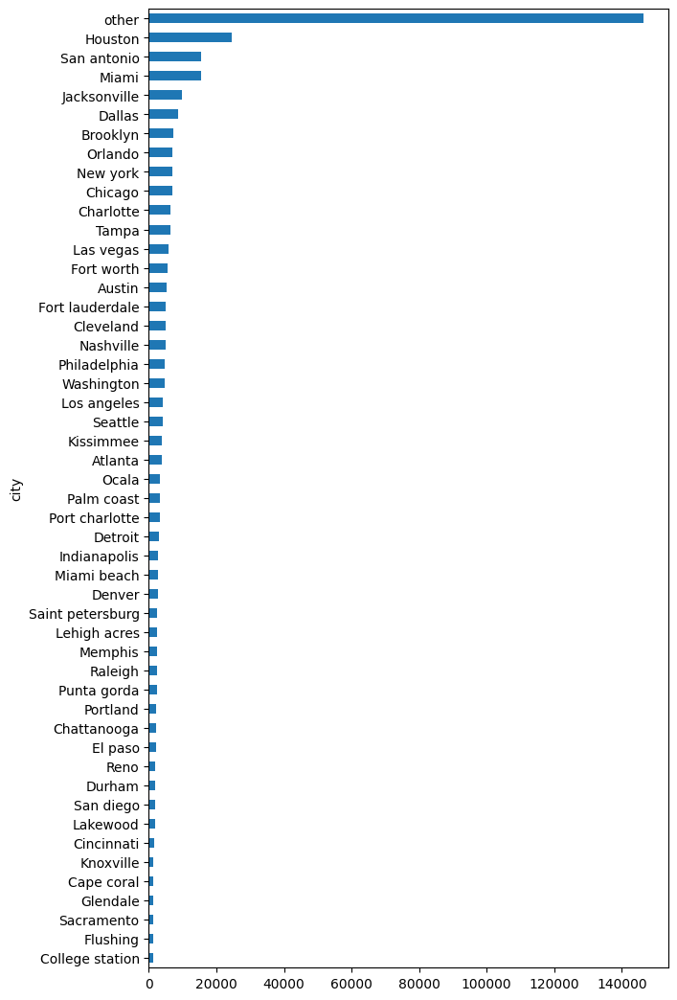

In [81]:
# посмотрим теперь на распределение признака город

data.city.value_counts(ascending=True).plot(kind='barh',  figsize=(7, 13))

<img src="visualisation/04.png?raw=true">

Конечно, теперь у нас получилось, что преобладает категория "others". Пожалуй, удалю этот признак сейчас, чтобы не возвращаться к нему позже.

In [82]:
# удалим колонку city
data = data.drop(['city'], axis=1)

##### zipcode

При создании таблицы zipcodes_cities, я заметила, что нам встречаются нереалистичные индексы, состоящие из нулей. Может быть были и другие странные индексы(слишком длинные или короткие), давайте посмотрим, что за объекты содержат такие индексы, и приведем их в порядок.

In [83]:
zipcode_len_mask = (data['zipcode'].str.len() > 5) | (data['zipcode'].str.len() < 4)

data.loc[zipcode_len_mask][:10]

,status,propertyType,baths,fireplace,sqft,zipcode,beds,state,stories,mls-id,...,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
3623,active,other,"1,500",1,"1,936",27606-1626,Baths,NC,NaN,NaN,...,1928,1950,,,,0.31 Acres,$163 / Sq. Ft.,3,False,1
5147,active,bungalow,"2,500",1,"1,742",27607-6632,Baths,NC,NaN,NaN,...,1950,1980,,,,0.30 Acres,$273 / Sq. Ft.,3,False,1
7092,active,ranch,"1,750",1,"1,194",27705-3261,Baths,NC,NaN,NaN,...,1940,,,,,0.28 Acres,$239 / Sq. Ft.,3,False,1
7478,active,traditional,NaN,1,"1,674",27603-2692,NaN,NC,NaN,NaN,...,1986,1986,,,,"8,276 Sq. Ft.",$146 / Sq. Ft.,3,False,1
8508,active,transitional,NaN,3,"6,517",27603-3986,NaN,NC,NaN,NaN,...,2014,2014,,,,3.39 Acres,$245 / Sq. Ft.,3,False,1
10977,active,traditional,NaN,1,"3,230",27613-8607,NaN,NC,NaN,NaN,...,2001,2001,,,,0.98 Acres,$116 / Sq. Ft.,3,False,1
13172,active,traditional,NaN,1,"1,358",27614-9829,NaN,NC,NaN,NaN,...,1999,1999,,,,—,$125 / Sq. Ft.,3,False,1
13243,active,traditional,NaN,2,"4,182",27703-7996,NaN,NC,NaN,NaN,...,2007,,,,,"7,187 Sq. Ft.",$97 / Sq. Ft.,3,False,1
14287,active,other,NaN,3,"7,427",27609-7611,NaN,NC,NaN,NaN,...,2001,2001,,,,0.66 Acres,$248 / Sq. Ft.,3,False,1
14628,active,traditional,"2,250",1,"1,752",27612-4911,Baths,NC,NaN,NaN,...,2007,2007,,,,"1,742 Sq. Ft.",$151 / Sq. Ft.,5,False,1


Посмотрим, реально ли могут быть такие почтовые индексы. К примеру, возьмем объект, расположенный в городе Raleigh по адресу 718 powell dr. Действительно, после пятизначного индекса там делается приписка. Возьмем Houston 14510 sw lantern ln n, издесь имеет место быть индекс 77015-2522. Значит, индексы длиной 10 символов тоже не трогаем. Посмотрим, что осталось.

In [84]:
# создадим список "странных" чисел
strange_list = [0, 00, 000, 0000, 00000]

zipcode_len_mask_2 = ((data['zipcode'].str.len() > 5) & (data['zipcode'].str.len() != 10)) | (data['zipcode'].str.len() < 4) | (data['zipcode'].isin(strange_list))

data.loc[zipcode_len_mask_2]

,status,propertyType,baths,fireplace,sqft,zipcode,beds,state,stories,mls-id,...,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
30065,active,land,NaN,NaN,0,0,NaN,CA,NaN,NaN,...,,,,,,222156,None,6,False,1
82977,new construction,colonial,NaN,NaN,NaN,0,NaN,NY,NaN,NaN,...,1995,,,Has Air Conditioning,,—,None,0,False,1
85027,active,2 stories,NaN,NaN,"4,000",123456,NaN,NY,NaN,NaN,...,1989,,"Ceiling Fan(s), Wall/Window Unit(s)",Has Cooling,,—,$225 / Sq. Ft.,0,False,1
111769,active,other,NaN,1,"2,399",27603-43,NaN,NC,NaN,NaN,...,2014,2013,,,,"3,920 Sq. Ft.",$147 / Sq. Ft.,3,False,2
133024,active,apartment,NaN,NaN,"1,100",112229,NaN,NY,NaN,NaN,...,2001,,,,,—,$545 / Sq. Ft.,4,False,1
160330,active,high rise,NaN,NaN,"1,212",331446,NaN,FL,NaN,NaN,...,2019,,Central Air,Has Cooling,,—,$512 / Sq. Ft.,5,False,1
229754,new construction,no type,NaN,NaN,NaN,--,449 acres,CA,NaN,OC19261036,...,,,,,,,,3,False,0
233641,no status,townhouse,3.0,NaN,"2,043",--,3,FL,NaN,NaN,...,2010,None,Forced air,Central,No Data,No Data,$208,3,False,1
241237,active,no type,"2,250",NaN,NaN,27713-967,Baths,NC,NaN,NaN,...,,,,,,0.81 Acres,None,3,False,0
303553,for sale,land,NaN,NaN,"243,849 sqft",0,NaN,TX,NaN,NaN,...,,,,,,58.00 acres,$7/sqft,1,False,1


Мы видим, что практически все эти объекты не имеют никакой информации о ванных, спальнях, но все-таки довольно много заполненных признаков, что говорит о теоретической реальности этих объектов. Все-таки индекс сам по себе не так важен, как местоположение в целом. А учитывая, что уже я использовала колонку индекса для извлечения города, пожалуй, удалю ее.

In [85]:
# удалим колонку zipcode
data = data.drop(['zipcode'], axis=1)
data.head(4)

,status,propertyType,baths,fireplace,sqft,beds,state,stories,mls-id,MlsId,...,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
0,active,single family,3.5,Gas Logs,2900,4,NC,NaN,NaN,611019,...,2019,,"Central A/C, Heat Pump",,,None,$144,8,False,1
1,for sale,single family,3 Baths,NaN,"1,947 sqft",3 Beds,WA,2.0,NaN,201916904,...,2019,,,,,5828 sqft,$159/sqft,3,False,1
2,for sale,single family,2 Baths,yes,"3,000 sqft",3 Beds,CA,1.0,NaN,FR19221027,...,1961,1967,Forced Air,Central,Attached Garage,"8,626 sqft",$965/sqft,3,True,1
3,for sale,single family,8 Baths,yes,"6,457 sqft",5 Beds,TX,3.0,NaN,14191809,...,2006,2006,Forced Air,Central,Detached Garage,"8,220 sqft",$371/sqft,4,False,1


##### Посмотрим, что из себя представляет признак state.

In [86]:
# посмотрим на количество пропусков в столбце
print(data.state.isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data.state.value_counts().index)

0
Index(['FL', 'TX', 'NY', 'CA', 'NC', 'TN', 'WA', 'OH', 'IL', 'NV', 'GA', 'CO',
       'PA', 'MI', 'DC', 'AZ', 'IN', 'OR', 'MA', 'UT', 'MD', 'VT', 'MO', 'VA',
       'WI', 'NJ', 'ME', 'IA', 'KY', 'OK', 'MS', 'SC', 'MT', 'DE', 'Fl', 'BA',
       'AL', 'OT', 'OS'],
      dtype='object', name='state')


In [87]:
# посмотрим на количество пропусков в столбце
data.target.isnull().sum()

0

Здесь все отлично, претензий нет, идем дальше.

#### Разберем признак 'baths' — количество ванных комнат.

In [88]:
# посмотрим на количество пропусков в столбце
print(data.baths.isnull().sum())

# Посмотрим, как выглядят данные ячеек
data.baths.value_counts().index[:10]

105347


Index(['2 Baths', '3 Baths', '2', '2.0', '4 Baths', '3.0', '3', 'Bathrooms: 2',
       '2.5', 'Bathrooms: 3'],
      dtype='object', name='baths')

Данные ячеек выглядят ужасно. Дробное количество ванных и огромные числа вносят дополнительный беспорядок. Попробуем привести все ячейки к одному формату и будем разбираться дальше.

In [89]:
def is_digit(string):
    if string.isdigit():
       return True
    else:
        try:
            float(string)
            return True
        except ValueError:
            return False

In [90]:
def get_clean_baths(bath):
    try:
        if is_digit(bath) is True:
            return bath
        else:
            text_list = bath.split(' ')
            if is_digit(text_list[0]) is True:
                return text_list[0]
                
            if is_digit(text_list[-1]) is True:
                return text_list[-1]

            else:
                return 0
    except AttributeError:
        return bath

data.baths = data.baths.apply(get_clean_baths)

# Посмотрим, как выглядят данные ячеек
data.baths.value_counts().index[10:]

Index(['3.5', '4.0', '0', '6', '1.5', '7', '5.0', '4.5', '8', '6.0', '9',
       '5.5', '7.0', '10', '750', '8.0', '11', '6.5', '12', '9.0', '1.75',
       '13', '10.0', '2.1', '16', '14', '2.75', '7.5', '18', '11.0', '15',
       '0.00', '12.0', '0.0', '8.5', '2.25', '13.0', '24', '20', '1.1', '3.1',
       '3.25', '17', '3.75', '22', '26', '1.25', '16.0', '30', '27', '23',
       '14.0', '21', '10.5', '15.0', '9.5', '40', '23.0', '32', '36', '19',
       '4.1', '0.75', '22.0', '12.5', '24.0', '28', '3.2', '4.25', '44', '2.2',
       '18.0', '29', '25', '34.0', '68', '6.75', '60', '20.0', '11.5', '42',
       '17.0', '30.0', '39', '64.0', '241', '0.5', '35', '116', '5.2', '76',
       '43', '41.0', '5.25', '34', '4.75', '55.0', '44.0'],
      dtype='object', name='baths')

Конечно, теперь у нас количество ванных комнат указано числами, но все еще непонятно, как может быть, например 3,5 ванных комнаты. Возможно, это площадь ванной комнаты, а не их количество. Но не буду округлять число(вдруг это важно), так как разных вариаций у нас уже не так много, чтобы это было критично, просто приведу к числовому формату. И если 10 ванных комнат мы еще можем понять, то 750 выглядит уже странно. Давайте посмотрим, что за объекты имеют нереалистичное количество ванных комнат.

In [91]:
# приведем данные к числовому формату
data.baths = data.baths.astype('float')
too_many_baths_mask = (data.baths >= 100)
data.loc[too_many_baths_mask].shape

(239, 21)

In [92]:
too_many_baths_mask = (data.baths >= 100)
print(data.loc[too_many_baths_mask].shape)
display(data.loc[too_many_baths_mask][:8])

(239, 21)


,status,propertyType,baths,fireplace,sqft,beds,state,stories,mls-id,MlsId,...,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
1095,active,other,750.0,1,"1,758",Baths,TX,NaN,NaN,14240509,...,1993,1993,,"Central A/C (Electric), Central Heat (Gas)",,"2,200 Sq. Ft.",$284 / Sq. Ft.,4,False,2
2000,active,no type,750.0,NaN,"1,367",NaN,DC,NaN,NaN,DCDC449992,...,2013,,,,,—,$1097 / Sq. Ft.,4,False,0
3563,active,no type,750.0,NaN,873,Baths,CO,NaN,NaN,7106586,...,1981,,"Forced Air, Natural Gas",Central Air,,—,$400 / Sq. Ft.,4,False,0
7497,active,no type,750.0,NaN,"1,864",Baths,CO,NaN,NaN,5419627,...,1936,1936,"Baseboard, Natural Gas, Steam",,,—,$300 / Sq. Ft.,3,False,0
7624,active,condo,750.0,3,"1,336",Baths,TX,3,NaN,14237911,...,1984,,,"Central A/C (Gas), Central Heat (Gas)",,—,$213 / Sq. Ft.,4,False,1
9728,active,no type,750.0,0,906,Baths,CO,NaN,NaN,3096963,...,1954,,"Forced Air, Natural Gas",Central Air,,"6,870 Sq. Ft.",$436 / Sq. Ft.,3,False,0
11028,for sale,single family,241.0,NaN,"Total interior livable area: 3,770 sqft",4 bd,TX,1.0,NaN,NaN,...,2014,2015,Forced air,Central,2 spaces,0.37 acres lot,$119,3,False,1
11524,active,other,750.0,NaN,856,NaN,DC,NaN,NaN,DCDC450942,...,2006,,,,,—,$789 / Sq. Ft.,4,False,1


Целевой признак здесь выглядит вполне вменяемо. Возможно, есть необходимость заменить такие нереальные значения на что-то более приземленное.

In [93]:
# заменим значение количества ванных комнат на медианное

# находим медиану по столбцу baths для всех строк, где baths < 100

median_baths = data.loc[(data.baths < 100), 'baths'].median()

# заменяем значения столбца baths, соответствующие маске, на медианное значение
data.loc[too_many_baths_mask, 'baths'] = median_baths

А теперь я подумала, что пропусков здесь было чересчур много, данные грязные, поэтому решила удалить эту колонку.

In [94]:
# удалим колонку baths
data = data.drop(['baths'], axis=1)
data.head(4)

,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
0,active,single family,Gas Logs,2900,4,NC,NaN,NaN,611019,418000,2019,,"Central A/C, Heat Pump",,,None,$144,8,False,1
1,for sale,single family,NaN,"1,947 sqft",3 Beds,WA,2.0,NaN,201916904,310000,2019,,,,,5828 sqft,$159/sqft,3,False,1
2,for sale,single family,yes,"3,000 sqft",3 Beds,CA,1.0,NaN,FR19221027,2895000,1961,1967,Forced Air,Central,Attached Garage,"8,626 sqft",$965/sqft,3,True,1
3,for sale,single family,yes,"6,457 sqft",5 Beds,TX,3.0,NaN,14191809,2395000,2006,2006,Forced Air,Central,Detached Garage,"8,220 sqft",$371/sqft,4,False,1


In [95]:
# посмотрим на количество пропусков в столбце
data.target.isnull().sum()

0

#### Разберем признак fireplace — наличие камина.

In [96]:
# приведем все значения столбца к нижнему регистру
# посмотрим на количество пропусков в столбце
data.fireplace = data.fireplace.str.lower()
data.fireplace.isnull().sum()

272137

In [97]:
# посмотрим, какие варианты заполнения существуют и как часто встречаются
data.fireplace.value_counts()[:10]

fireplace
yes               70634
1                 14533
2                  2432
not applicable     1990
fireplace           847
3                   563
living room         433
location            399
wood burning        311
gas/gas logs        300
Name: count, dtype: int64

Очень уж пропусков и много разных вариантов описания у нас в данных, сузим это количество. Можно указать в этом признаке не просто наличие камина, но и их количество. 

Предположим, что если указано 'yes', это означает, что камин один. Если указано no, not applicable, n/k это 0. fireplace yn - видимо, владельцы не определились, есть у них камин или нет, значит нет. В тех случаях, когда идет перечисление, мы видим, что идет описание камина - в каком он помещении, как устроен. Начнем обработку признака и в процессе будем смотреть, каким он становится.

In [98]:
# Пропусков довольно много. Заменим их на 0

data.fireplace = data.fireplace.fillna(0)
data.fireplace.isnull().sum()

0

In [99]:
def get_clean_fireplace(fireplace):    
    non_fireplace_list = ['no', 'not applicable', 'n/k', 'fireplace yn']
    try:
        if fireplace in non_fireplace_list:
            return 0
        if fireplace.isdigit() is True:
                return fireplace
        else:
            return 1
    except AttributeError:
        return fireplace
    
data.fireplace = data.fireplace.apply(get_clean_fireplace).astype(int)
data.fireplace.value_counts()

fireplace
0     275020
1      96324
2       2432
3        563
4        184
5         65
6         35
7         18
8          5
9          3
10         3
11         2
12         1
Name: count, dtype: int64

Посмотрим на объекты, в которых 8 каминов и более.

In [100]:
print(data.loc[(data.fireplace >= 8)].shape)
display(data.loc[(data.fireplace >= 8)][:8])

(14, 20)


,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
147767,active,no type,11,"30,104",Baths,CO,NaN,NaN,6097947,19750000,2008,2008,"Forced Air, Heat Pump",Central Air,,3.88 Acres,$656 / Sq. Ft.,3,False,0
168242,active,single family,8,4476,6.0,OH,3.00,NaN,4142567,515000,1903,,"Forced Air, Hot Water/Steam",Central Air,,20038,$115,8,False,1
195226,active,other,9,"13,995",Baths,TX,NaN,NaN,13820486,6750000,2007,2004,,"Additional Water Heater(s), Electrostatic Air ...",,0.88 Acres,$482 / Sq. Ft.,4,False,3
198120,active,no type,12,"13,464",Baths,TX,NaN,NaN,14225965,2950000,2011,,,"Central A/C (Electric), Central Heat (Electric)",,—,$219 / Sq. Ft.,4,False,0
216954,active,other,10,"10,823",NaN,DC,NaN,NaN,DCDC447248,12000000,2000,,,,,0.50 Acres,$1109 / Sq. Ft.,5,False,1
243889,active,other,8,"4,476",NaN,OH,NaN,NaN,4142567,515000,1903,1972,Central Air,Has Cooling,,0.46 Acres,$115 / Sq. Ft.,3,False,1
262560,active,other,9,"10,511",Baths,TX,NaN,NaN,13997215,18500000,1929,1980,,"Additional Water Heater(s), Central A/C (Elect...",,10 Acres,$1760 / Sq. Ft.,4,False,2
275522,active,single family,10,3851,5.0,TX,2,NaN,51491575,659900,,,,Central Electric,,19984,$171,8,False,1


Мы видим, что эти объекты имеют довольно бльшую плозадь и высокую стоимость, то еть логических расхождений нет.

In [101]:
# посмотрим на количество пропусков в столбце
data.target.isnull().sum()

0

#### Перейдем к следующему признаку: sqft — площадь в футах. Для понимания - 1 квадратный фут = 0.09290304 кв.м.

In [102]:
# посмотрим на количество пропусков в столбце
print(data.sqft.isnull().sum())

# и посмотрим, как выглядят данные в колонке
data.sqft.value_counts().index[:10]

40095


Index(['0', '1,200 sqft', '1,000 sqft', '1,100 sqft', '1,800 sqft',
       '1,500 sqft', '--', '2,000 sqft', '1,400 sqft', '1,600 sqft'],
      dtype='object', name='sqft')

Очистим данные и приведем к числовому формату. Имеет смысл убрать запятую, разделяющую числа и лишние слова.

In [103]:
def get_clean_sqft(sqft):
    try:
        sqft = sqft.replace(',', '')
        sqft = sqft.replace("'", "")
        sqft = sqft.replace('\n', '')
        if sqft.isdigit() is True:
            return sqft
        else:
            sqft_list = sqft.split(' ')
            for i in range(0, len(sqft_list) - 1):
                if sqft_list[i].isdigit() is True:
                    return sqft_list[i]
                
    except AttributeError:
        return None
        
data.sqft = data.sqft.apply(get_clean_sqft)

# посмотрим, как выглядят данные в колонке
data.sqft.value_counts().index[:10]

Index(['0', '1200', '1000', '1500', '1800', '1100', '1400', '2000', '1600',
       '800'],
      dtype='object', name='sqft')

In [104]:
# приведем к числовому формату
data.sqft = data.sqft.astype('Int32')
data.sqft.info()

<class 'pandas.core.series.Series'>
RangeIndex: 374655 entries, 0 to 374654
Series name: sqft
Non-Null Count   Dtype
--------------   -----
333748 non-null  Int32
dtypes: Int32(1)
memory usage: 1.8 MB


Я заметила, что у части объектов в признаке beds указана площадь(???).
Ну что, тогда посмотрим, что полезного мы можем взять из признака beds.

In [105]:
# посмотрим, как выглядят данные в колонке
data.beds.value_counts().index[:10]

Index(['3 Beds', '4 Beds', '3', '2 Beds', '4', '2', 'Baths', '3 bd', '5 Beds',
       '4 bd'],
      dtype='object', name='beds')

В колонке количества спален содержится информация о площади земель, попробую извлечь ее в отдельный столбец. Заодно вместе с ней возьму и те данные, где имеется приписка sqft. 1 акр это 43560 футов.

In [106]:
# приведем все значения столбца к нижнему регистру
data.beds = data.beds.str.lower()
# удалим пробелы в начале и конце строки
data.beds = data.beds.str.strip()

# и посмотрим, как выглядят данные в колонке
data.beds.value_counts().index[:10]

Index(['3 beds', '4 beds', '3', '2 beds', '4', '2', 'baths', '3 bd', '5 beds',
       '4 bd'],
      dtype='object', name='beds')

In [107]:
def get_acres(beds):  
    try:
        if 'acres' in beds or 'acre' in beds:
            text_list = beds.split(' ')
            if is_digit(text_list[0]) is True:
                return (float(text_list[0]) * 43560)
            if is_digit(text_list[-1]) is True:
                return (float(text_list[-1]) * 43560)
        if 'sqft' in beds:
            beds = beds.replace(' sqft', '')
            beds = beds.replace(',', '')
            return beds
        else:
            return None
    except TypeError:
        return None
    
data['acres'] = data.beds.apply(get_acres)

# посмотрим на количество пропусков в столбце
data.target.isnull().sum()

0

##### Разберем новый свежесозданный столбец acres.

In [108]:
# посмотрим на количество пропусков в столбце
print(data.acres.isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data.acres.value_counts().index[:10])

371681
Index([              '--',             '5000',            43560.0,
       14810.400000000001, 12196.800000000001,            11325.6,
                  12632.4,            44866.8,            '10001',
                  13068.0],
      dtype='object', name='acres')


Посмотрим на объекты, площадь для которых мы извлекли из признака Beds.

In [109]:
acres_mask = data.acres.notna()
print(data.loc[acres_mask].shape)
display(data.loc[acres_mask][:7])

(2974, 21)


,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,...,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount,acres
272,no status,no type,0,<NA>,0.25 acres,TX,NaN,NaN,1368899,46000,...,None,None,None,None,None,None,3,False,0,10890.0
481,no status,no type,0,<NA>,0.44 acres,FL,NaN,NaN,O5731775,495000,...,None,None,None,None,None,None,3,False,0,19166.4
536,no status,no type,0,<NA>,1.43 acres,FL,NaN,NaN,T3198357,349900,...,None,None,None,None,None,None,3,False,0,62290.8
721,no status,no type,0,<NA>,0.32 acres,TX,NaN,NaN,58400586,75000,...,None,None,None,None,None,None,3,False,0,13939.2
957,no status,no type,0,<NA>,"8,637 sqft",TX,NaN,NaN,13806376,350000,...,None,None,None,None,None,None,3,False,0,8637
1190,no status,no type,0,<NA>,9.7 acres,FL,NaN,NaN,T2288006,1650000,...,None,None,None,None,None,None,3,False,0,422532.0
1402,no status,no type,0,<NA>,"10,310 sqft",TX,NaN,NaN,79882785,108000,...,None,None,None,None,None,None,3,False,0,10310


Видимо, это участки, поэтому у них нет никакой информации ни о спальнях, ни о кондиционировании и прочее. Поменяю тип этих объектов на land. И при дальнейшей обработке буду это иметь в виду. Пожалуй, стоит добавить площадь этих объектов в колонку sqrt, так как у данных объектов она как раз не была заполнена.

In [110]:
# заменим тип объектов на land
data.loc[acres_mask, 'propertyType'] = 'land'

In [111]:
data['sqft'] = data['acres'].fillna(data['sqft'])

# удалим первоначальные колонки и посмотрим, какие теперь значения в столбце sqft
data = data.drop(columns=['acres'])

data.sqft.value_counts().index[:10]

Index([0, 1200, 1000, 1500, 1800, 1100, 1400, 2000, 1600, 800], dtype='object', name='sqft')

In [112]:
# приведем столбец к числовому виду
data.sqft = pd.to_numeric(data.sqft, errors='coerce')

# посмотрим на количество пропусков в столбце
print(data.sqft.isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data.sqft.value_counts().index[:10])

38033
Index([0.0, 1200.0, 1000.0, 1500.0, 1800.0, 1100.0, 1400.0, 2000.0, 1600.0,
       800.0],
      dtype='float64', name='sqft')


In [113]:
# заменим пропуски в колонке 0
data.sqft = data.sqft.fillna(0)

# посмотрим на количество пропусков в столбце
print(data.sqft.isnull().sum())

0


In [114]:
# посмотрим на взаимосвязь полученных площадей и целевого признака 
# в логарифмическом масштабе для наглядности

fig = px.scatter(
    data, 
    y='sqft', 
    x='target', 
    color='target',
    height=1000,
    width=1000,
    title='Взаимосвязь площади объекта и его стоимости',
    color_continuous_scale=px.colors.diverging.Tealrose,
    log_x=True,
    log_y=True
    )

fig.show()

<img src="visualisation/26.png?raw=true">

Посмотрим на объекты с нереально огромными площадями - более 5 млн футов (это больше 464 тыс. кв.м.).

In [115]:
mask_big_sqft = data.sqft > 5000000
print(data.loc[mask_big_sqft].shape)
display(data.loc[mask_big_sqft][:5])

(10, 20)


,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
62337,for sale,single family,1,795979430.0,2 beds,OH,1.0,NaN,1230095,27500,1901,,Forced Air,Wall,"Attached Garage, Carport",2874 sqft,$0/sqft,11,False,1
73726,for sale,land,0,7078574.0,NaN,TX,NaN,NaN,20193268,98000,,,,,,12.73 acres,$0/sqft,2,False,1
120119,no status,land,0,8015040.0,184 acres,FL,NaN,NaN,A10384323,1675000,None,None,None,None,None,None,None,3,False,0
141219,for sale,land,0,5728968.0,NaN,WA,NaN,NaN,19-1033,289000,,,,,,126.00 acres,$0/sqft,4,False,1
145764,no status,land,0,23609520.0,542 acres,FL,NaN,NaN,1002721,10255777,None,None,None,None,None,None,None,3,False,0


In [116]:
# удалим эти объекты

data = data.drop(data.loc[mask_big_sqft].index).reset_index(drop=True)
data.shape

(374645, 20)

Также на графике мы увидели, что есть выбросы, как по площади, так и по цене. Давайте посмотрим на большие объекты с маленькой ценой и наоборот.

In [117]:
little_price_mask = (data['target'] <= 10) & (data['sqft'] >= 1000)
display(data.loc[little_price_mask])

,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
15426,active,single family,0,1596.0,3.0,TN,1.00,NaN,2108367,1,1940,,Heating Source,,"Detached, ASPHT",87120,No Info,8,False,1
25168,no status,single family,1,1586.0,3,IN,0,NaN,21683478,1,1957,1957,Other,Central,Detached Garage,0.54 acres,None,3,False,1
84396,foreclosed,land,1,2536.0,6 beds,OH,2.0,NaN,1623043,1,1865,,,Central,Detached Garage,0.31 acres,$0/sqft,1,False,1
250945,active,2 stories,1,1771.0,NaN,OH,NaN,NaN,219044578,1,1920,,,"Boiler, Gas, Hot Water",,"3,367 Sq. Ft.",None,4,False,1
254486,no status,condo,1,1780.0,3,IN,0,NaN,21674783,1,1989,1989,Other,Central,1 space,None,None,3,False,1
275739,foreclosed,multi family,1,3226.0,3 beds,OH,3.0,NaN,1642998,1,1870,,Baseboard,"Central, Wall",4,0.39 acres,$0/sqft,10,False,1
287254,foreclosed,single family,1,1596.0,3 beds,TN,1.0,NaN,2108367,1,1940,1975,Forced Air,None,Detached Garage,2.0 acres,$0/sqft,3,False,1
302028,foreclosed,single family,1,1586.0,3 beds,IN,NaN,NaN,21683478,1,1957,1957,Other,Central,Detached Garage,0.54 acres,$0/sqft,1,False,1
319368,foreclosed,condo,1,1780.0,3 beds,IN,NaN,NaN,21674783,1,1989,1989,Other,Central,Attached Garage,"4,417 sqft",$0/sqft,3,False,1


Ну пусть для объектов со статусом foreclosed указание такой цены - нормальное явление. Удалим объекты, соответствующие вышеуказанному условию + не в статусе foreclosed.

In [118]:
little_price_mask_2 = (data['target'] <= 10) & (data['sqft'] >= 1000) & (data['status'] != 'foreclosed')
data = data.drop(data.loc[little_price_mask_2].index).reset_index(drop=True)

Посмотрим на объекты стоимостью более 10 млн долларов, с микроскопической площадью.

In [119]:
big_price_mask = (data.target >= 1000000) & (data.sqft <= 10)
print(data.loc[big_price_mask].shape)
display(data.loc[big_price_mask][:8])

(6642, 20)


,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
15,new construction,2 stories,0,0.0,NaN,NY,NaN,NaN,3182740,1650000,1905,1905,,Steam Heating,,"2,003 Sq. Ft.",None,3,False,1
41,for sale,land,0,0.0,NaN,CA,NaN,NaN,190057878,1100000,,,,,,9.25 acres,None,3,False,1
213,active,no type,0,0.0,NaN,NY,NaN,NaN,DEGI3377205,3950000,,,,,,—,None,4,False,0
216,for sale,coop,0,0.0,6 beds,NY,NaN,NaN,00112959,15000000,1930,,,,,,None,7,False,1
380,active,no type,0,0.0,NaN,NY,NaN,NaN,VERU1843026,1699000,,,,,,—,None,4,False,0
430,active,no type,0,0.0,NaN,NY,NaN,NaN,DEGI3979395,3150000,,,,,,—,None,6,False,0
495,active,land,0,0.0,NaN,WA,NaN,NaN,1192155,1200000,1993,,,,,78844,None,8,False,1
655,active,no type,0,0.0,NaN,NY,NaN,NaN,DEGI3471965,1725000,,,,,,—,None,5,False,0


In [120]:
# удалим их
data = data.drop(data.loc[big_price_mask].index)
data.shape

(367999, 20)

#### Разберем признак beds — количество спален.

In [121]:
# посмотрим на количество пропусков в столбце
data.target.isnull().sum()

0

In [122]:
# посмотрим на количество пропусков в столбце
print(data.beds.isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data.beds.value_counts().index[:10])

85465
Index(['3 beds', '4 beds', '3', '2 beds', '4', '2', 'baths', '3 bd', '5 beds',
       '4 bd'],
      dtype='object', name='beds')


Во-первых, есть смысл изъять данные площадей, во-вторых, убрать все лишние знаки, символы и слова.

In [123]:
def del_sqft_from_beds(beds):
    try:
        if 'sqft' in beds or 'acres' in beds:
            return None
        else:
            return beds
    except TypeError:
        return beds
data.beds = data.beds.apply(del_sqft_from_beds)

print(data.beds.value_counts().count())

146


Даже с учетом загрязненных данных у осталось не так много различных вариаций строк. Приведу их в порядок, для того чтобы данные были в числовом формате(количество спален).

In [124]:
# слегка подчистим столбец
def get_clean_bedss(beds):
    try:
        beds = beds.replace(',', '')
        if is_digit(beds) is True:
            return beds
        else:
            text_list = beds.split(' ')
            if is_digit(text_list[0]) is True:
                return text_list[0]
            if is_digit(text_list[-1]) is True:
                return text_list[-1]

            else:
                return None
    except AttributeError:
        return None

data.beds = data.beds.apply(get_clean_bedss)

# заменим пропуски медианным значением по столбцу
median_beds = data['beds'].median()
data.beds = data.beds.fillna(median_beds)

# приведем к числовому формату
data.beds = data.beds.astype(float)
data.beds.info()

# Посмотрим, как выглядят данные ячеек
print(data.beds.value_counts().index)

<class 'pandas.core.series.Series'>
Index: 367999 entries, 0 to 374640
Series name: beds
Non-Null Count   Dtype  
--------------   -----  
367999 non-null  float64
dtypes: float64(1)
memory usage: 5.6 MB
Index([  3.0,   4.0,   2.0,   5.0,   6.0,   1.0,   7.0,   0.0,   8.0,   9.0,
        10.0,  12.0,  11.0,  16.0,  13.0,  64.0,  14.0,  15.0,  18.0,  24.0,
        20.0,  17.0,  28.0,  32.0,  26.0,  22.0,  19.0,  21.0,  27.0,  30.0,
        23.0,  34.0,  44.0,  36.0,  40.0,  25.0,  47.0,  33.0,  48.0,  78.0,
        42.0,  39.0,  76.0,  35.0,  46.0,  52.0,  99.0,  29.0,  75.0,  51.0,
        53.0,  31.0, 144.0,  88.0],
      dtype='float64', name='beds')


In [125]:
# посмотрим на те объекты, где более 30 спален
print(data.loc[(data.beds > 30)].shape)
display(data.loc[(data.beds > 30)][:8])

(87, 20)


,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
3325,active,multi family,0,12052.0,32.0,CA,NaN,NaN,19-467508,3600000,1965,,Wall Heater,Wall Unit(s),0,14871,$299,8,False,1
6261,for sale,land,0,0.0,64.0,NC,NaN,NaN,952829,250000,,,,,,0.42 acres,None,3,False,1
7261,active,multi family,0,62376.0,144.0,TX,NaN,NaN,20193851,1590000,,,Central Electric,Central Electric,,275258,$25,8,False,1
21323,for sale,multi family,0,1100.0,32.0,FL,2.0,NaN,H10668287,1704000,1974,,Forced Air,Central,22,,"$1,549/sqft",4,True,1
28016,for sale,multi family,0,12582.0,36.0,CA,NaN,NaN,WS19268807,6500000,1901,1906,Wall,None,Detached Garage,"9,751 sqft",$517/sqft,3,False,1
28598,for sale,land,0,0.0,64.0,NC,NaN,NaN,3430247,39900,,,,,,0.46 acres,None,3,False,1
32597,active,multi family,0,16675.0,48.0,NC,NaN,NaN,3425127,2189000,1954,,,Central Air,Driveway,None,$131,8,False,1
33946,for sale,land,0,0.0,64.0,NC,NaN,NaN,927080,23500,,,,,,"8,276 sqft",None,3,False,1


Это земли, либо многоквартирные дома. Если с многоквартирными домами все понятно, то откуда на участке спальни? Палатки? Заменим на 0 все значения количества спален, относящиеся к объектам типа land.

In [126]:
# заменим значение количества спален на землях на 0

data.loc[(data['propertyType'] == 'land'), 'beds'] = '0'

# приведем к числовому формату
data.beds = data.beds.astype(float)
data.beds.info()

<class 'pandas.core.series.Series'>
Index: 367999 entries, 0 to 374640
Series name: beds
Non-Null Count   Dtype  
--------------   -----  
367999 non-null  float64
dtypes: float64(1)
memory usage: 5.6 MB


#### Переходим к признаку stories - количество этажей.

In [127]:
# посмотрим на количество пропусков в столбце
print(data.stories.isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data.stories.value_counts().index[:10])

143429
Index(['1.0', '2.0', '1', '2', '3.0', '0.0', 'One', '0', '3', '9.0'], dtype='object', name='stories')


Почти половина объектов имеют пропущенное значение количества этажей. Можно предположить, что это квартиры, которые стандартно состоят из 1 этажа, нам важно просто обозначить их все одинаково. Таке мы видим, что значения признака требуют доработки.

In [128]:
# приведем столбец к числовому виду
data.stories = pd.to_numeric(data.stories, errors='coerce')

# заменим возможно пропуски на 0
data.stories = data.stories.fillna(0)

# Посмотрим, как выглядят данные ячеек
print(data.stories.value_counts().index)

# посмотрим на количество пропусков в столбце
print(data.stories.isnull().sum())

Index([   0.0,    1.0,    2.0,    3.0,    9.0,    4.0,    6.0,    1.5,    5.0,
          7.0,    8.0,    2.5,   12.0,   16.0,   11.0,   20.0,   14.0,   15.0,
         17.0,   13.0,   10.0,   21.0,   19.0,   18.0,   23.0,   25.0,   24.0,
         33.0,   22.0,   30.0,   27.0,   40.0,   31.0,   1.75,   29.0,   43.0,
         26.0,   28.0,   46.0,   32.0,   36.0,    1.7,   47.0,   38.0,   41.0,
         42.0,   45.0,   35.0,   39.0,   60.0,   34.0,   70.0,   48.0,   57.0,
         37.0,   44.0,   66.0,   54.0,   77.0,   52.0,   80.0,   51.0,   90.0,
         49.0,   56.0,   55.0,   63.0,   58.0,   91.0,   62.0,   68.0,   78.0,
         64.0,    1.3,   75.0,   95.0,   50.0,    3.5,    1.2,   82.0, 1120.0,
          2.2, 1002.0,   96.0,   65.0],
      dtype='float64', name='stories')
0


Бурдж Халифа в ОАЭ имеет 163 этажа, а в самом высоком здании США на данный момент 108 этажей, вряд ли в наших объектах больше этого числа.

In [129]:
# посмотрим, где у нас более 108 этажей
mask_stories = data.stories > 108
display(data.loc[mask_stories])

,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
221418,for sale,condo,0,425.0,3.0,FL,1120.0,974565,NaN,53000,1949,1980,Forced air,Central,,25 sqft lot,$125,2,False,1
314485,for sale,townhouse,1,1497.0,3.0,OR,1002.0,201909859,NaN,325000,2006,,Forced air,Central,1 space,"2,613 sqft lot",$217,3,False,1


In [130]:
# удалим эти объекты

data = data.drop(data.loc[mask_stories].index).reset_index(drop=True)

# Посмотрим, как выглядят данные ячеек
print(data.stories.value_counts().index)

Index([ 0.0,  1.0,  2.0,  3.0,  9.0,  4.0,  6.0,  1.5,  5.0,  7.0,  8.0,  2.5,
       12.0, 16.0, 11.0, 20.0, 14.0, 15.0, 17.0, 13.0, 10.0, 21.0, 19.0, 18.0,
       23.0, 25.0, 24.0, 33.0, 22.0, 30.0, 40.0, 27.0, 31.0, 1.75, 29.0, 26.0,
       43.0, 28.0, 46.0, 32.0, 36.0,  1.7, 38.0, 42.0, 41.0, 47.0, 45.0, 39.0,
       35.0, 60.0, 34.0, 70.0, 48.0, 37.0, 57.0, 44.0, 66.0, 77.0, 54.0, 52.0,
       90.0, 51.0, 80.0, 56.0, 55.0, 63.0, 49.0, 58.0, 91.0, 68.0, 62.0, 64.0,
       78.0,  3.5, 50.0,  1.3, 75.0, 95.0, 82.0,  1.2,  2.2, 96.0, 65.0],
      dtype='float64', name='stories')


#### Переходим к извлеченному ранее признаку Year built - год постройки. Разберем его в совокупности с другим признаком - Remodeled year - год реконструкции.

In [131]:
# посмотрим на количество пропусков в столбце
print(data['Year built'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['Year built'].value_counts().index[:10])

3548
Index(['', '2019', '2006', '2005', '2007', '2018', '2004', '2017', '2016',
       '2008'],
      dtype='object', name='Year built')


Пропусков не так много, визуально данные тоже выглядят нормально.

In [132]:
# посмотрим на количество пропусков в столбце
print(data['Remodeled year'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['Remodeled year'].value_counts().index[:10])

26159
Index(['', '2006', '2005', '2007', '2008', '2004', '1980', '1970', '2000',
       '2003'],
      dtype='object', name='Remodeled year')


In [133]:
# удалю колонку Remodeled year
data = data.drop(['Remodeled year'], axis=1)

# посмотрим на пропуски в колонке Year built
print(data.loc[data['Year built'].isna()].shape)

display(data.loc[data['Year built'].isna()][:8])

(3548, 19)


,status,propertyType,fireplace,sqft,beds,state,stories,mls-id,MlsId,target,Year built,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount
268,no status,land,0,10890.0,0.0,TX,0.0,NaN,1368899,46000,None,None,None,None,None,None,3,False,0
316,no status,no type,0,4041.0,5.0,FL,2.0,NaN,"0067, Royal Cypress Preserve, Orlando, FL 32836",632995,None,None,None,None,None,None,1,False,0
475,no status,land,0,19166.4,0.0,FL,0.0,NaN,O5731775,495000,None,None,None,None,None,None,3,False,0
529,no status,land,0,62290.8,0.0,FL,0.0,NaN,T3198357,349900,None,None,None,None,None,None,3,False,0
711,no status,land,0,13939.2,0.0,TX,0.0,NaN,58400586,75000,None,None,None,None,None,None,3,False,0
940,no status,land,0,8637.0,0.0,TX,0.0,NaN,13806376,350000,None,None,None,None,None,None,3,False,0
1169,no status,land,0,422532.0,0.0,FL,0.0,NaN,T2288006,1650000,None,None,None,None,None,None,3,False,0
1264,no status,multi family,0,0.0,3.0,FL,0.0,NaN,NaN,2275,None,Other,Central,2 spaces,None,$2,2,False,1


In [134]:
# приведем столбец к числовому виду
data['Year built'] = pd.to_numeric(data['Year built'], errors='coerce')

# посмотрим на количество пропусков в столбце
print(data['Year built'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['Year built'].value_counts().index[:10])

57841
Index([2019.0, 2006.0, 2005.0, 2007.0, 2018.0, 2004.0, 2017.0, 2016.0, 2008.0,
       2003.0],
      dtype='float64', name='Year built')


In [135]:
fig = px.box(
    data_frame=data,
    x = data['Year built'],
    title='Распределение годов постройки',
    color_discrete_sequence=px.colors.diverging.Tealrose,
    log_x=True
)
fig.show()

<img src="visualisation/05.png?raw=true">

In [136]:
# воспользуюсь методом межквартильного размаха для очистки от выбросов
# создам функцию 
def outliers_iqr(data, feature):
    x = data[feature]
    quartile_1, quartile_3 = x.quantile(0.25), x.quantile(0.75),
    iqr = quartile_3 - quartile_1
    lower_bound = quartile_1 - (iqr * 1.5)
    upper_bound = quartile_3 + (iqr * 1.5)
    outliers = data[(x<lower_bound) | (x > upper_bound)]
    cleaned = data[(x>lower_bound) & (x < upper_bound)]
    return outliers, cleaned

outliers, data = outliers_iqr(data, 'Year built')
print(f'Число выбросов по методу Тьюки: {outliers.shape[0]}')
print(f'Результирующее число записей: {data.shape[0]}')

Число выбросов по методу Тьюки: 1137
Результирующее число записей: 309001


#### Признак Heating - обогрев.

In [137]:
# посмотрим на количество пропусков в столбце
print(data['Heating'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['Heating'].value_counts().index[:10])

0
Index(['Forced Air', '', 'Forced air', 'Other', 'No Data', 'Central Air',
       'Electric', 'Gas', 'Central Electric', 'Central'],
      dtype='object', name='Heating')


Есть пропуски, также есть строки, которые содержат по несколько разных вариантов обогрева.

In [138]:
# приведем все значения столбца к нижнему регистру
data.Heating = data.Heating.str.lower()
# удалим пробелы в начале и конце строки
data.Heating = data.Heating.str.strip()

# заменим все пропуски на 'no data', так как такое значение уже попадалось мне на глаза

data['Heating'] = data['Heating'].fillna('no data')
data['Heating'] = data['Heating'].replace('', 'no data')

# посмотрим на количество пропусков в столбце
print(data['Heating'].isnull().sum())

0


In [139]:
# Посмотрим, какие варианты обогрева есть и в каком количестве
types = set()
types_list = []
for index, value in data['Heating'].items():
    pre_types = value
    pre_types = pre_types.replace('[', '').replace(']', '')
    pre_types = pre_types.replace("'", '')
    pre_types = pre_types.split(",")
    for i in pre_types:
        types.add(i.strip())
        types_list.append(i.strip())

# заменим все образовавшиеся пропуски на 'no data'
data['Heating'] = data['Heating'].fillna('no data')
data['Heating'] = data['Heating'].replace('', 'no data')

print(f'Пропущенных значений в данных: {data.Heating.isnull().sum()}')
        
print(f'Количество уникальных типов обогрева: {len(types)}')
print(f'Всего типов обогрева: {len(types_list)}')

Пропущенных значений в данных: 0
Количество уникальных типов обогрева: 689
Всего типов обогрева: 333790


Вариантов обогрева получилось очень много, давайте попробуем сократить их количество, объединив похожие варианты в группы, а также обработаем те строки, в которых указано несколько вариантво обогрева. Будем делать все последовательно, маленькими шажками, чтобы ничего не потерять и не сломать.

In [140]:
def get_short_string(type):
    type = type.split(",")
    if len(type) == 1:
        return ''.join(type)
    else:
        return ''.join(type[0])

data['Heating'] = data['Heating'].apply(get_short_string)

# посмотрим, как выглядят данные в колонке
print(data['Heating'].value_counts().index[:10])

Index(['forced air', 'no data', 'other', 'central', 'central air',
       'central electric', 'heat pump', 'electric', 'gas', 'baseboard'],
      dtype='object', name='Heating')


In [141]:
# уберем лишние символы из текста
def remove_special_symbols(arg):
    pattern = r'[^a-zA-Z ]'
    cleaned_arg = re.sub(pattern, '', arg)
    return cleaned_arg

data['Heating'] = data['Heating'].apply(remove_special_symbols)

Из того, что попалось на глаза: lp gas - liquefied petroleum gas, nat gas - natural gas, heat pumpelectric - heat pump, central air - central. Несколько сокращу число вариантов, воспользовавшись дедукцией.

In [142]:
def get_clean_heating(arg):
    if 'conditioner' in arg:
        return 'air conditioner'
    if 'other' in arg:
        return 'other'
    if 'central' in arg:
        return 'central'
    if 'lp' in arg:
        return 'liquefied petroleum gas'
    if 'nat' in arg or 'propan' in arg:
        return 'natural gas'
    if 'pump' in arg:
        return 'pump'
    if 'electric' in arg:
        return 'electric'
    if 'mini' in arg:
        return 'minisplit'
    if 'fan' in arg:
        return 'fan'
    if 'wall' in arg:
        return 'wall'
    if 'oil' in arg:
        return 'oil'
    if 'gas' in arg:
        return 'gas'
    if 'window' in arg:
        return 'window'
    if 'water' in arg:
        return 'water'
    if 'split' in arg:
        return 'split'
    if 'electric' in arg:
        return 'electric'
    if 'air ventilation' in arg:
        return 'air ventilation'
    else:
        return arg
    
data['Heating'] = data['Heating'].apply(get_clean_heating)

# посмотрим, как выглядят данные в колонке
print(data['Heating'].value_counts().count())

222


In [143]:
# Оставим 30 самых популярных значений, остальные обозначим как other
heating_count_list = data.Heating.value_counts()[:29].index
def get_clean_heating(heating):
    if heating in heating_count_list:
        return heating
    else:
        return 'other'
    
data.Heating = data.Heating.apply(get_clean_heating)
data.Heating.value_counts().count()

29

#### Признак Cooling - кондиционирование.

In [144]:
# посмотрим на количество пропусков в столбце
print(data['Cooling'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['Cooling'].value_counts().index[:10])

0
Index(['Central', '', 'Central Air', 'No Data', 'Has Cooling', 'None',
       'Central Electric', 'Wall', 'Central Gas', 'Central Heating'],
      dtype='object', name='Cooling')


Здесь ситуация идентичная признаку Heating. Обработаем признак.

In [145]:
# приведем все значения столбца к нижнему регистру
data.Cooling = data.Cooling.str.lower()

# удалим пробелы в начале и конце строки
data.Cooling = data.Cooling.str.strip()

# заменим все пропуски на 'no data'
data['Cooling'] = data['Cooling'].fillna('no data')
data['Cooling'] = data['Cooling'].replace('', 'no data')

In [146]:
# Посмотрим, какие варианты охлаждения есть и в каком количестве
types = set()
types_list = []
for index, value in data['Cooling'].items():
    pre_types = value
    pre_types = pre_types.replace('[', '').replace(']', '')
    pre_types = pre_types.replace("'", '')
    pre_types = pre_types.split(",")
    for i in pre_types:
        types.add(i.strip())
        types_list.append(i.strip())

# заменим все образовавшиеся пропуски на 'no data'
data['Cooling'] = data['Cooling'].fillna('no data')
data['Cooling'] = data['Cooling'].replace('', 'no data')

data['Cooling'].isnull().sum()
        
print(f'Количество уникальных типов обогрева: {len(types)}')
print(f'Всего типов обогрева: {len(types_list)}')

Количество уникальных типов обогрева: 306
Всего типов обогрева: 333209


In [147]:
# избавимся от списков с помощью функции get_short_string
data['Cooling'] = data['Cooling'].apply(get_short_string)

# уберем лишние символы из текста с помощью функции remove_special_symbols
data['Cooling'] = data['Cooling'].apply(remove_special_symbols)

# посмотрим, как выглядят данные в колонке теперь
print(data['Cooling'].value_counts().index[:10])

Index(['central', 'no data', 'central air', 'has cooling', 'central electric',
       'none', 'central gas', 'wall', 'central ac electric',
       'central heating'],
      dtype='object', name='Cooling')


In [148]:
def get_clean_cooling(arg):
    if 'central' in arg:
        return 'central'
    if 'other' in arg or 'has' in arg or 'included' in arg:
        return 'other'
    if 'boiler' in arg:
        return 'boiler'
    if 'window' in arg:
        return 'window'
    if 'wall' in arg:
        return 'wall'
    if 'stove' in arg:
        return 'stove'
    if 'dual' in arg:
        return 'dual'
    if 'floor' in arg:
        return 'floor'
    if 'pump' in arg:
        return 'pump'
    if 'fan' in arg:
        return 'fan'
    if 'central air' in arg:
        return 'central air'
    if 'individual' in arg:
        return 'individual'
    if 'ventilator' in arg:
        return 'ventilator'
    if 'see' in arg:
        return 'other'
    if 'none' in arg or 'not' in arg:
        return 'no data'
    if 'included' in arg:
        return 'central'
    else:
        return arg
    
data['Cooling'] = data['Cooling'].apply(get_clean_cooling)

print(data['Cooling'].value_counts().count()) 

128


In [149]:
# Оставим 30 самых популярных значений, остальные обозначим как other
# воспользуемся функцией get_clean_heating

heating_count_list = data.Cooling.value_counts()[:29].index
    
data.Cooling = data.Cooling.apply(get_clean_heating)
data.Cooling.value_counts().count()

29

#### Признак Parking	 - парковка.

In [150]:
# посмотрим на количество пропусков в столбце
print(data['Parking'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['Parking'].value_counts().index[:10])

0
Index(['', 'Attached Garage', '2 spaces', '1 space', 'Detached Garage',
       'No Data', 'Carport', '3 spaces', 'Off Street', '1'],
      dtype='object', name='Parking')


Ситуация схода с двумя предыдущими признаками. Разберем этот признак детально, частично используя предыдущие методы. Возможно, попробую извлечь из этих данных количество парковочных мест, а не тип парковки.

In [151]:
# приведем все значения столбца к нижнему регистру
data.Parking = data.Parking.str.lower()

# удалим пробелы в начале и конце строки
data.Parking = data.Parking.str.strip()

# заменим все пропуски на 'no data'
data['Parking'] = data['Parking'].fillna('no data')

In [152]:
# создам функцию для извлечения чисел из строк

def get_num_from_parking(arg):
    if len(arg) > 1:
        arg_list = arg.split(',')
        for text in arg_list:
            for elem in text:
                if elem.isdigit():
                    arg = elem
    else:
        return arg
    return arg
    
data['Parking'] = data['Parking'].apply(get_num_from_parking)

# посмотрим, как выглядят данные в колонке
print(data['Parking'].value_counts().index[:10])

Index(['', 'attached garage', '2', '1', 'detached garage', 'no data',
       'carport', '3', 'off street', '4'],
      dtype='object', name='Parking')


In [153]:
# избавимся от списков с помощью функции get_short_string

data['Parking'] = data['Parking'].apply(get_short_string)

# уберем лишние символы из текста с помощью функции remove_special_symbols

data['Parking'] = data['Parking'].apply(remove_special_symbols)

# посмотрим, как выглядят данные в колонке теперь
print(data['Parking'].value_counts().index.tolist()[:10])

['', 'attached garage', 'detached garage', 'no data', 'carport', 'off street', 'none', 'on street', 'driveway', 'parking desc']


In [154]:
# объединим похожие описания с помощью функции

def get_clean_parking(arg):
    if 'none' in arg or 'not' in arg:
        return 'no data'
    if 'off street' in arg:
        return 'off street'
    if 'on street' in arg:
        return 'on street'
    if 'attached' in arg:
        return 'attached'
    if 'detached' in arg:
        return 'detached'
    if 'garage' in arg:
        return 'garage'
    if 'under' in arg:
        return 'under building'
    if 'driveway' in arg:
        return 'driveway'
    if 'assigned' in arg:
        return 'assigned'
    if 'unassigned' in arg:
        return 'unassigned'
    if 'guest' in arg:
        return 'guest'
    if 'assigned' in arg:
        return 'assigned'
    if 'parking' in arg:
        return 'parking'
    if 'private' in arg:
        return 'private'
    if 'public' in arg:
        return 'public'
    
    
data['Parking'] = data['Parking'].apply(get_clean_parking)

# заменим все пропуски на 'no data'
data['Parking'] = data['Parking'].fillna('no data')
data['Parking'] = data['Parking'].replace('', 'no data')

# посмотрим, как выглядят данные в колонке
print(data['Parking'].value_counts()) 

Parking
no data           205378
attached           73486
detached           14290
off street          7267
parking             2413
on street           2119
driveway            2033
garage              1208
assigned             666
under building        74
guest                 40
private               17
public                10
Name: count, dtype: int64


#### Признак lotsize

In [155]:
# посмотрим на количество пропусков в столбце
print(data['lotsize'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['lotsize'].value_counts().index[:10])

20773
Index(['', '—', 'No Data', '-- sqft lot', '0.26 acres', '0.28 acres',
       '0.25 acres', '0.27 acres', '0.29 acres', '6,098 sqft'],
      dtype='object', name='lotsize')


In [156]:
# приведем все значения столбца к нижнему регистру
data['lotsize'] = data['lotsize'].str.lower()
# удалим пробелы в начале и конце строки
data['lotsize'] = data['lotsize'].str.strip()

In [157]:
def calc_lotsize(lotsize):
    try:
        if 'acres' in lotsize or 'acre' in lotsize:
            text_list = lotsize.split(' ')
            if is_digit(text_list[0]) is True:
                return (float(text_list[0]) * 43560)
            if is_digit(text_list[-1]) is True:
                return (float(text_list[-1]) * 43560)
        if 'sq' in lotsize:
            text_list = lotsize.split(' ')
            if is_digit(text_list[0]) is True:
                return is_digit(text_list[0])
            if is_digit(text_list[-1]) is True:
                return is_digit(text_list[-1])
        else:
            if is_digit(lotsize) is True:
                return lotsize
            else:   
                return lotsize
    except TypeError:
        return lotsize
data.lotsize = data.lotsize.apply(calc_lotsize)

# посмотрим на количество пропусков в столбце
print(data.lotsize.isnull().sum())

# посмотрим, как выглядят данные в колонке
print(data.lotsize.value_counts().index[:10])

153923
Index([                '',                '—',               True,
                'no data',            11325.6, 12196.800000000001,
                  11761.2,            10890.0,            12632.4,
                  13068.0],
      dtype='object', name='lotsize')


In [158]:
# удаляем все символы, кроме цифр и точки
data['lotsize'] = data['lotsize'].str.replace(r"[^\d\.]", "", regex=True)

# заменим пропущенные значения на 0 и приведем признак к числовому типу
data['lotsize'] = data['lotsize'].fillna('0')
data['lotsize'] = data['lotsize'].replace('', '0')
data['lotsize'] = data['lotsize'].str.rstrip('.').astype(float)

print(data['lotsize'].value_counts().index[:10])

Index([0.0, 10019.0, 7405.0, 10890.0, 8276.0, 6098.0, 8712.0, 9583.0, 7841.0,
       6534.0],
      dtype='float64', name='lotsize')


#### Признак Price/sqft

In [159]:
# посмотрим на количество пропусков в столбце
print(data['Price/sqft'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['Price/sqft'].value_counts().index[:10])

12330
Index(['', '$1/sqft', 'No Data', 'No Info', '$125/sqft', '$115/sqft',
       '$119/sqft', '$123', '$118', '$120/sqft'],
      dtype='object', name='Price/sqft')


In [160]:
# удаляем все символы, кроме цифр и точки
data['Price/sqft'] = data['Price/sqft'].str.replace(r"[^\d]", "", regex=True)

# заменим пропущенные значения на 0 и приведем к числовому формату
data['Price/sqft'] = data['Price/sqft'].fillna('0')
data['Price/sqft'] = data['Price/sqft'].replace('', '0').astype(float)

print(data['Price/sqft'].value_counts().index[:10])

Index([0.0, 125.0, 123.0, 121.0, 128.0, 115.0, 130.0, 127.0, 135.0, 122.0], dtype='float64', name='Price/sqft')


####  Признак school_rating_count - этот признак я создала, обозначающий количество школ поблизости, и он не нуждается в обработке.

In [161]:
# посмотрим на количество пропусков в столбце
print(data['school_rating_count'].isnull().sum())

# и посмотрим, как выглядят данные в колонке
print(data['school_rating_count'].value_counts().index)

0
Index([ 3,  8,  2,  5,  4,  6,  1,  7,  0, 24, 13, 10, 63, 12, 11, 15,  9, 22,
       14, 65, 49, 16, 61, 21, 17, 19, 26],
      dtype='int64', name='school_rating_count')


#### Перейдем к признакам mls-id и MlsId — идентификатор MLS (Multiple Listing Service, система мультилистинга)

In [162]:
# посмотрим на количество пропусков в столбце mls-id	
print(data['mls-id'].isnull().sum())

# и посмотрим, как выглядят данные в столбце mls-id	
print(data['mls-id'].value_counts().index[:10])

284658
Index(['No ', 'No MLS#', '19-5523', '39888954', '190004138', '233481',
       '19010197', '201909981', '617190', '20193103'],
      dtype='object', name='mls-id')


In [163]:
# посмотрим на количество пропусков в столбце MlsId	
print(data['MlsId'].isnull().sum())

# и посмотрим, как выглядят данные в столбце MlsId	
print(data['MlsId'].value_counts().index[:10])

51675
Index(['NO MLS', 'No MLS #', ' A, Houston, TX 77008', 'No ',
       ' B, Houston, TX 77008', ' 1, South Boston, MA 02127', 'No mls',
       ' 2, Washington, DC 20002', ' B, Houston, TX 77007',
       ' 1, Washington, DC 20002'],
      dtype='object', name='MlsId')


In [164]:
# объединим колонки в новую
data['MLS'] = data['mls-id'].fillna(data['MlsId'])

# удалим первоначальные колонки и посмотрим на характеристики столбца 'MLS'
data = data.drop(columns=['mls-id', 'MlsId'])

print(data['MLS'].isnull().sum())

27332


Так как уникальных идентификаторов довольно много, при этом есть отсутствующие, я просто укажу в этом признаке на наличие или отсутствие MLS.

In [165]:
# приведем все значения столбца к нижнему регистру
data.MLS = data.MLS.str.lower()

# удалим пробелы в начале и конце строки
data.MLS = data.MLS.str.strip()

In [166]:
def bool_lms(mls):
    try:
        if 'no mls' in mls or mls == 'no':
            return False
        else:
            return True
    except TypeError:
        return False
    
data['MLS'] = data.MLS.apply(bool_lms)
print(data['MLS'].value_counts())

MLS
True     281597
False     27404
Name: count, dtype: int64


### Сохраню полученный датафрейм, чтобы проще было работать с данными дальше, не потеряв ничего ценного. Будем обращаться к нему при необходимости.

In [167]:
data.to_csv(r'./data/processed_data.csv', index=False)

В следующей части проекта нас ждет:

* Разведывательный анализ данных (EDA).
* Отбор и преобразование признаков.
* Построение нескольких моделей для прогнозирования стоимости недвижимости.